In [1]:
from legend_plot_style import LEGENDPlotStyle as lps

In [2]:
lps.use('legend_talks')

In [3]:
import os
import pandas as pd
import numpy  as np

import matplotlib.pyplot as plt
import matplotlib.dates  as mdates

from datetime   import datetime, timezone
from legendmeta import LegendMetadata

lmeta = LegendMetadata('/Users/romoluque_c/Repositories/legend-metadata/')

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [5]:
data_path = '/Users/romoluque_c/LEGEND/TAUP_evt_rate_ana/data_test/skimmed_files'

def read_and_concat_data(group, count, path=data_path):
    dfs = [pd.read_hdf(f'{path}/{group}_r{index:03d}_high_level.hdf')
           for index in range(count)]
    return pd.concat(dfs, verify_integrity=True)

data_p03 = read_and_concat_data('p03', 6)
data_p04 = read_and_concat_data('p04', 4)

## Express timestamps in seconds
data_p03.index = pd.to_datetime(data_p03.index, unit='s')
data_p04.index = pd.to_datetime(data_p04.index, unit='s')

dt    = datetime(2023, 4, 22, 5, 54, 22, tzinfo=timezone.utc)
chmap = lmeta.hardware.configuration.channelmaps.on(dt)

In [6]:
runs_start_lines = []
runs_end_lines   = []
for filename in np.sort([file for file in os.listdir(data_path) if file.endswith(".hdf")]):
    df_filename  = pd.read_hdf(data_path+'/'+filename)
    start_run_t  = pd.to_datetime(df_filename.index[0],  unit='s')
    ending_run_t = pd.to_datetime(df_filename.index[-1], unit='s')
    runs_start_lines.append(start_run_t)
    runs_end_lines  .append(ending_run_t)
    
runs_start_lines = np.array(runs_start_lines)
runs_end_lines   = np.array(runs_end_lines  )

In [7]:
channel_dict = {}
for channel_name, channel_data in chmap.items():
    try:
        channel_dict[channel_data['daq']['rawid']] = (lmeta.channelmap(dt)[channel_name].type,
                                                      channel_name,
                                                      lmeta.channelmap(dt)[channel_name].production['mass_in_g'],
                                                      lmeta.channelmap(dt)[channel_name].location  ['string'],
                                                      lmeta.channelmap(dt)[channel_name].location  ['position'])
    except:
        continue

In [8]:
## Add detector type, channel name and detector mass to dataframe according to the channel id

channel_df = pd.DataFrame.from_dict(channel_dict, orient='index', columns=['det_type', 'channel_name', 'mass', 'string', 'position'])
data_p03   = pd.merge(data_p03, channel_df, left_on='channel_id', right_index=True, how='left')
data_p04   = pd.merge(data_p04, channel_df, left_on='channel_id', right_index=True, how='left')

In [157]:
def data_selection(data):
    return data[(data.is_pulser        == False) & 
                (data.is_baseline      == False) & 
                (data.is_muon_tagged   == False) & 
                (data.is_valid_channel == True)  & 
                (data.multiplicity     == 1)     &
                (data.is_physical      == True)]

def data_selection_no_mult(data):
    return data[(data.is_pulser        == False) & 
                (data.is_baseline      == False) & 
                (data.is_muon_tagged   == False) & 
                (data.is_valid_channel == True)  &
                (data.is_physical      == True)]

def resample_df(df, timestamp='H'): ## returns the event rates in mHz (evt rate per hour /3600 sec *1000 mHz)
    event_rate_df        = df.resample(timestamp).size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    return event_rate_df_series

def resample_df_norm_mass(df, timestamp='H'): ## returns the event rates in mHz normalizing with the mass of each detector
    event_rate_df        = df.resample(timestamp).size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    summed_mass          = df.resample(timestamp).sum().mass/1000 #transform to kg
    event_rate_norm      = event_rate_df_series/summed_mass
    return event_rate_norm.fillna(0)

def resample_df_norm_keV_kg(df, timestamp='H'): ## returns the event rates in mHz*keV/kg
    event_rate_df        = df.resample(timestamp).size()
    event_rate_df_series = pd.Series(event_rate_df.values*(1000/3600), index=event_rate_df.index)
    summed_mass          = df.resample(timestamp).sum().mass/1000 #transform to kg
    summed_energy        = df.resample(timestamp).sum().energy #keV
    event_rate_norm      = (event_rate_df_series*summed_energy)/summed_mass
    return event_rate_norm.fillna(0)

In [10]:
all_cuts = [('is_pulser',        False),
            ('is_baseline',      False),
            ('is_muon_tagged',   False),
            ('is_valid_channel', True),
            ('multiplicity',     1),
            ('is_physical',      True)]

colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

vert_line_date     = pd.to_datetime('2023-04-14')
vert_line_datetime = pd.to_datetime('2023-04-14 8:00')
vert_line_num      = mdates.date2num(vert_line_datetime)

In [11]:
data_p03_filt = data_selection(data_p03)
data_p04_filt = data_selection(data_p04)

data_p03_no_mult = data_selection_no_mult(data_p03)
data_p04_no_mult = data_selection_no_mult(data_p04)

data_p03_Getrig = data_p03[~(data_p03.channel_id == 999)]
data_p04_Getrig = data_p04[~(data_p04.channel_id == 999)]

### Join p3 and p4
data         = pd.concat([data_p03,         data_p04],         verify_integrity=True)
data_filt    = pd.concat([data_p03_filt,    data_p04_filt],    verify_integrity=True)
data_no_mult = pd.concat([data_p03_no_mult, data_p04_no_mult], verify_integrity=True)
data_Getrig  = pd.concat([data_p03_Getrig,  data_p04_Getrig],  verify_integrity=True)

data_series        = resample_df(data)
data_filt_series   = resample_df(data_filt)
data_Getrig_series = resample_df(data_Getrig)

data_days_series      = resample_df(data,      timestamp='D')
data_days_filt_series = resample_df(data_filt, timestamp='D')

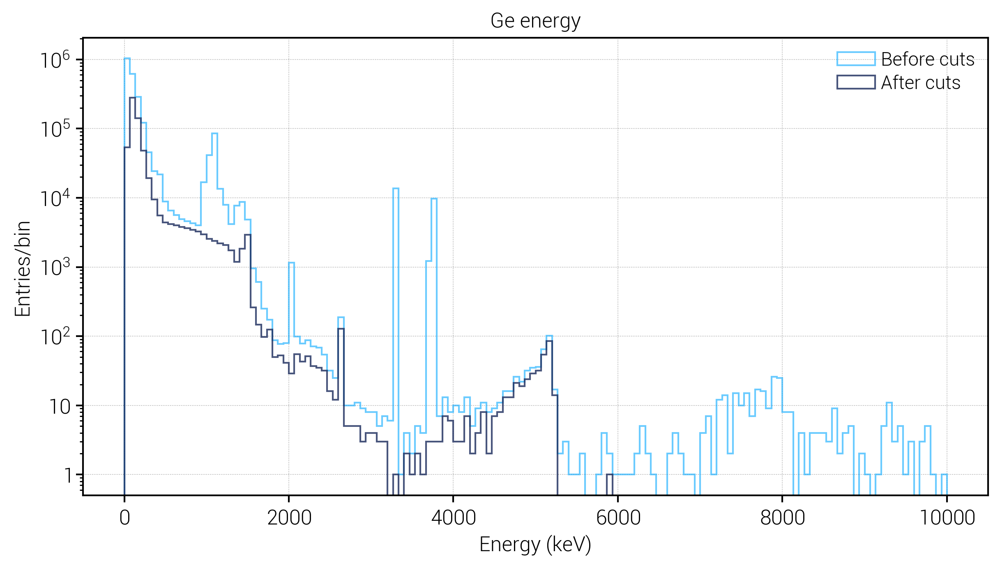

In [12]:
fig, ax = lps.subplots()
data     .energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.6, label='Before cuts', histtype='step', color=lps.colors['legend_blue'])
data_filt.energy.hist(bins=150, range=(0, 10000), log=True, alpha=0.8, label='After cuts' , histtype='step', color=lps.colors['legend_darkblue'])
plt.title('Ge energy')
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(loc=1);

In [13]:
legend_colors = np.array(list(lps.colors.keys()))
legend_colors

array(['legend_grey', 'legend_blue', 'legend_darkblue', 'legend_orange',
       'legend_green', 'legend_violet', 'legend_gold', 'legend_darkgreen',
       'legend_purple', 'black', 'red', 'yellow', 'green', 'purple',
       'silver', 'salmon', 'violet', 'darkblue', 'grey', 'gray',
       '1sigma_green', '2sigma_yellow', 'mint', 'forestgreen', 'orange',
       'darkred', 'sand', 'lightgrey', 'lightgray', 'jet', 'teal'],
      dtype='<U16')

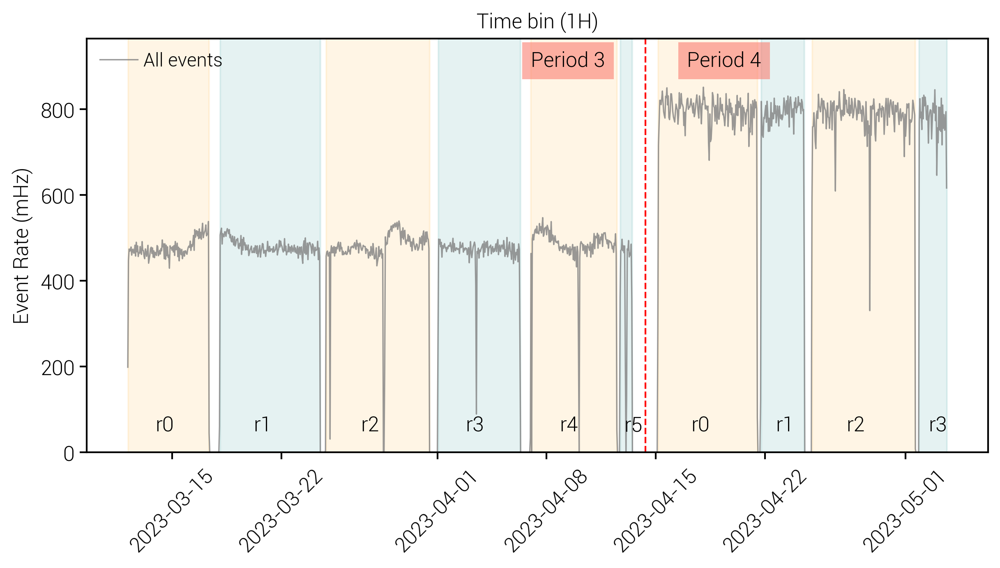

In [14]:
fig, ax = lps.subplots()
plt.plot(data_series       .index, data_series,        linewidth=0.8, color='grey', alpha=0.8, label='All events')

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 900, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 900, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for i, (irun, frun) in enumerate(zip(runs_start_lines, runs_end_lines)):
    if (i % 2)==1:
        color='teal'
    else:
        color='orange'
    plt.axvspan(irun, frun, color=color, alpha=0.1)
    if i>5:
        i=i-6
    midpoint = irun + (frun - irun) / 3
    plt.text(midpoint, 50, 'r'+str(i))
    
plt.title('Time bin (1H)')
plt.ylabel('Event Rate (mHz)')
plt.legend(loc='upper left', fontsize=11)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.ylim(0, 965)
plt.show()

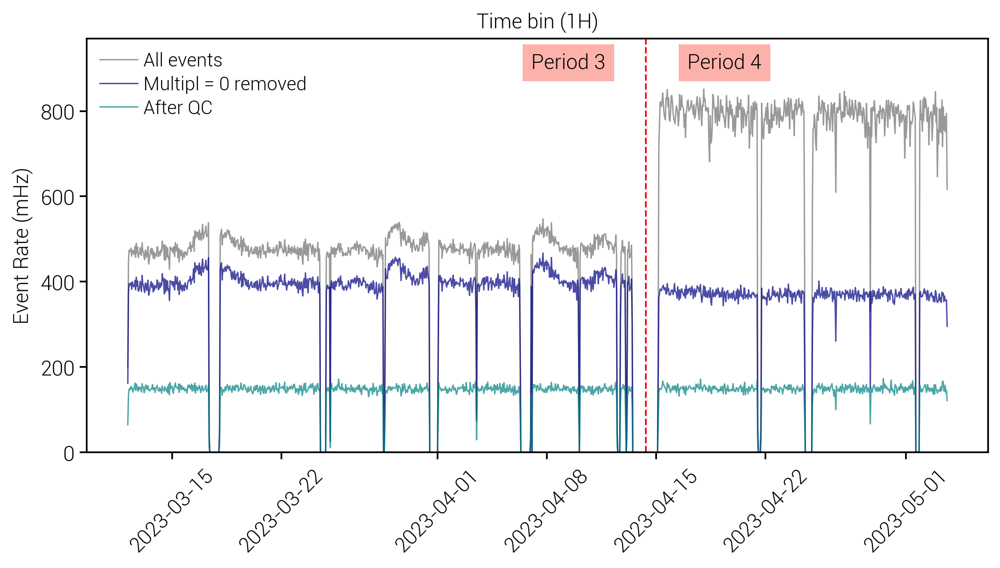

In [75]:
fig, ax = lps.subplots()
ax.plot(data_series       .index, data_series,        linewidth=0.8, color='grey', alpha=0.8, label='All events')
ax.plot(data_Getrig_series.index, data_Getrig_series, linewidth=0.8, color='navy', alpha=0.7, label='Multipl = 0 removed')
ax.plot(data_filt_series  .index, data_filt_series,   linewidth=0.8, color='teal', alpha=0.7, label='After QC')

ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
ax.text(pd.to_datetime('2023-04-07'), 900, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
ax.text(pd.to_datetime('2023-04-17'), 900, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
ax.set_title('Time bin (1H)')
ax.set_ylabel('Event Rate (mHz)')
plt.legend(loc='upper left', fontsize=11)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.ylim(0, 970)
#plt.yscale('log')
plt.show()

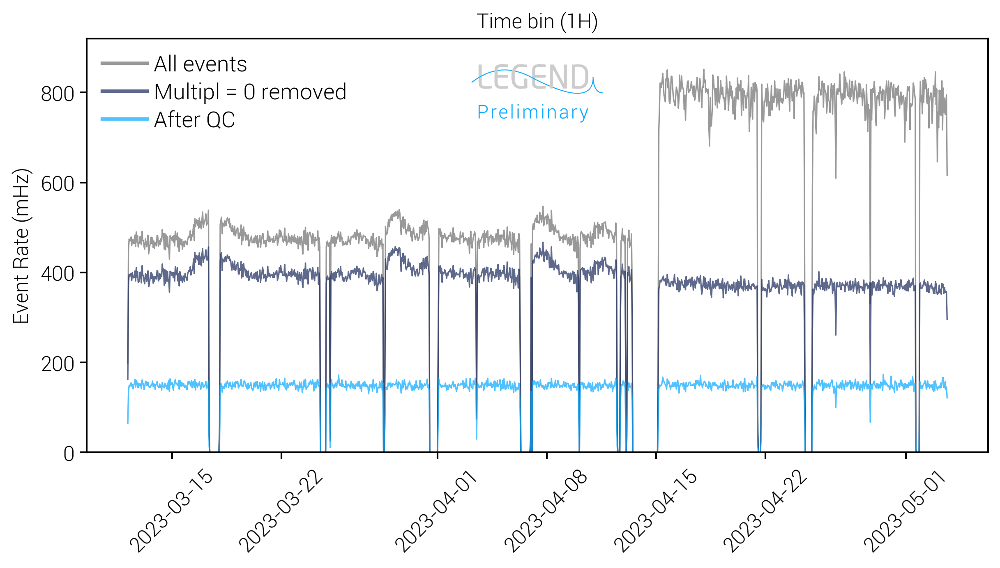

In [224]:
fig, ax = lps.subplots()
ax.plot(data_series       .index, data_series,        linewidth=0.8, color='grey',                        alpha=0.8, label='All events')
ax.plot(data_Getrig_series.index, data_Getrig_series, linewidth=0.8, color=lps.colors['legend_darkblue'], alpha=0.7, label='Multipl = 0 removed')
ax.plot(data_filt_series  .index, data_filt_series,   linewidth=0.8, color=lps.colors['legend_blue'],     alpha=0.7, label='After QC')
ax.set_legend_logo(position='upper center', logo_type = 'preliminary')
ax.set_title('Time bin (1H)')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=1, fontsize=13, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

plt.xticks(rotation=45)
plt.ylim(0, 920)
plt.show()

### Multiplicity

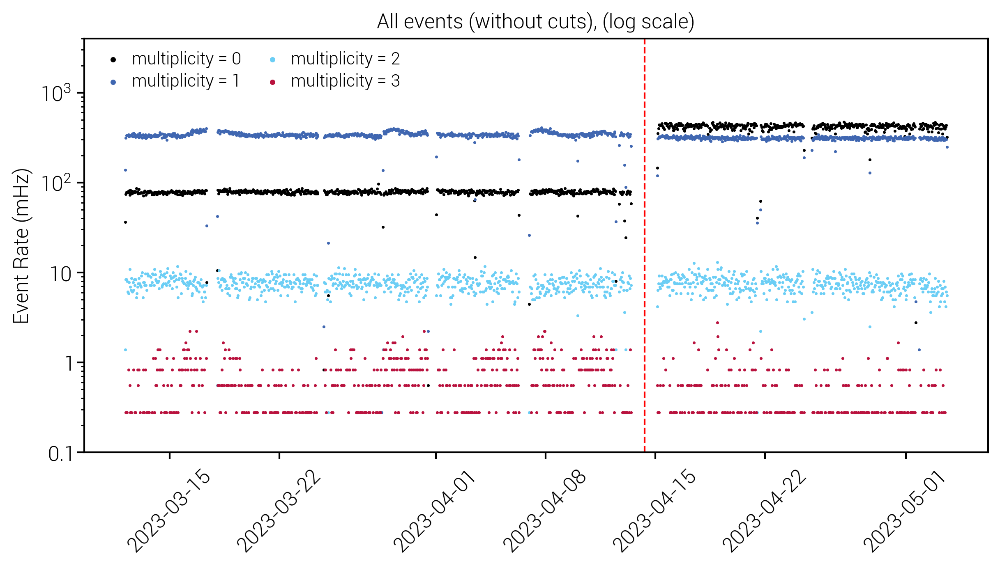

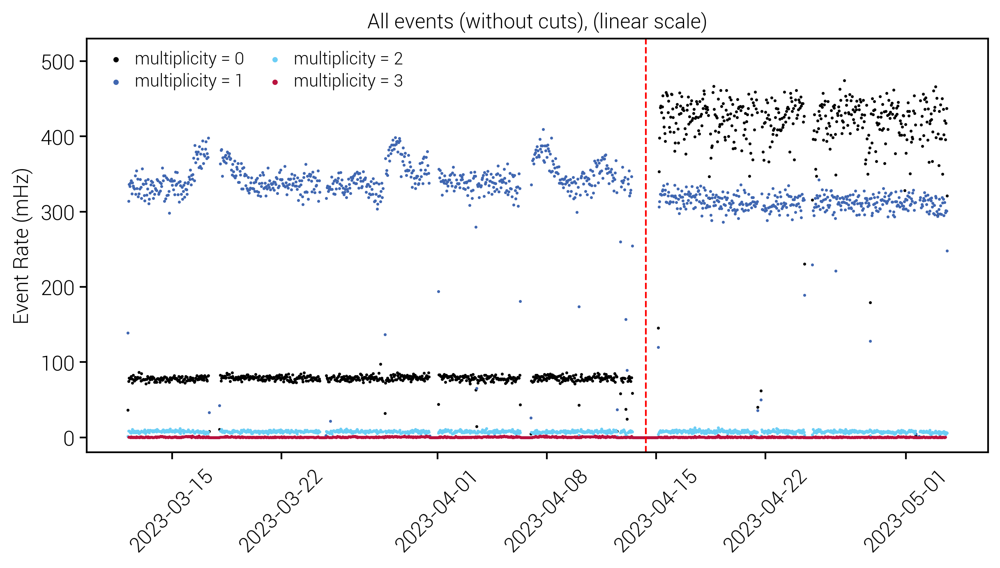

In [16]:
for i, titl in enumerate(['(log scale)', '(linear scale)']):
    fig, ax = lps.subplots()
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    for mult, col in zip(range(4), colors):
        data_m = resample_df(data[data.multiplicity==mult])
        ax.scatter(data_m.index, data_m, s=2, color=col, label=f'multiplicity = {mult}')
        ax.set_title(f'All events (without cuts), {titl}')
        ax.set_ylabel('Event Rate (mHz)')
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
        plt.legend(ncol=2, fontsize=10, loc='upper left', markerscale=3, handletextpad=0.1)

    if i==0:
        ax.set_ylim(10**(-1), 4000)
        ax.set_yscale('log')
    else:
        ax.set_ylim(-20, 530)
    plt.show()

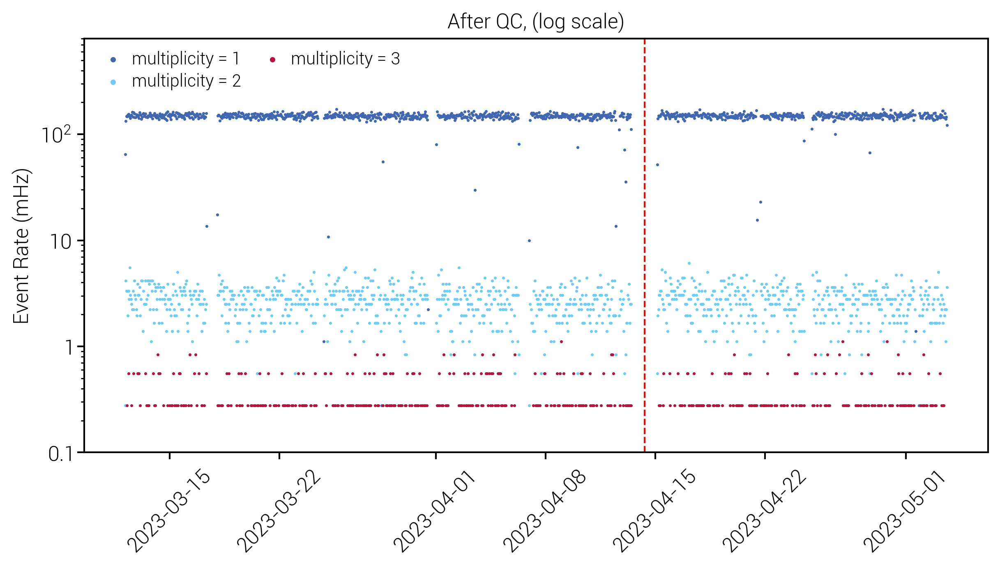

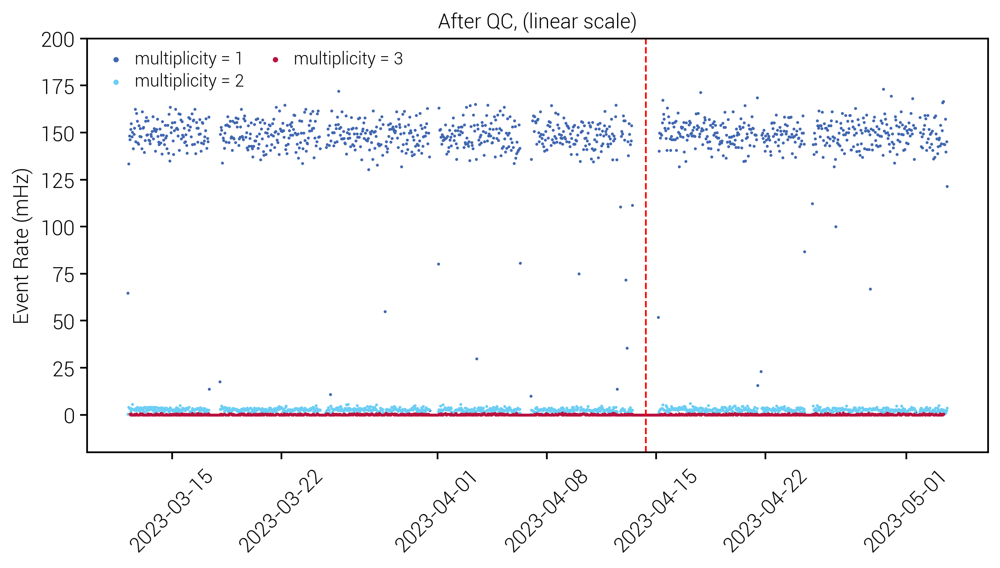

In [17]:
for i, titl in enumerate(['(log scale)', '(linear scale)']):
    fig, ax = lps.subplots()
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    for mult, col in zip(np.arange(1,4), colors[1:]):
        data_m = resample_df(data_no_mult[data_no_mult.multiplicity==mult])
        ax.scatter(data_m.index, data_m, s=2, color=col, label=f'multiplicity = {mult}')
        ax.set_title(f'After QC, {titl}')
        ax.set_ylabel('Event Rate (mHz)')
        plt.legend(ncol=2, fontsize=10, loc='upper left', markerscale=3, handletextpad=0.1)
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

    if i==0:
        ax.set_ylim(10**(-1), 800)
        ax.set_yscale('log')
    else:
        ax.set_ylim(-20, 200)
    plt.show()

### Apply cuts individually

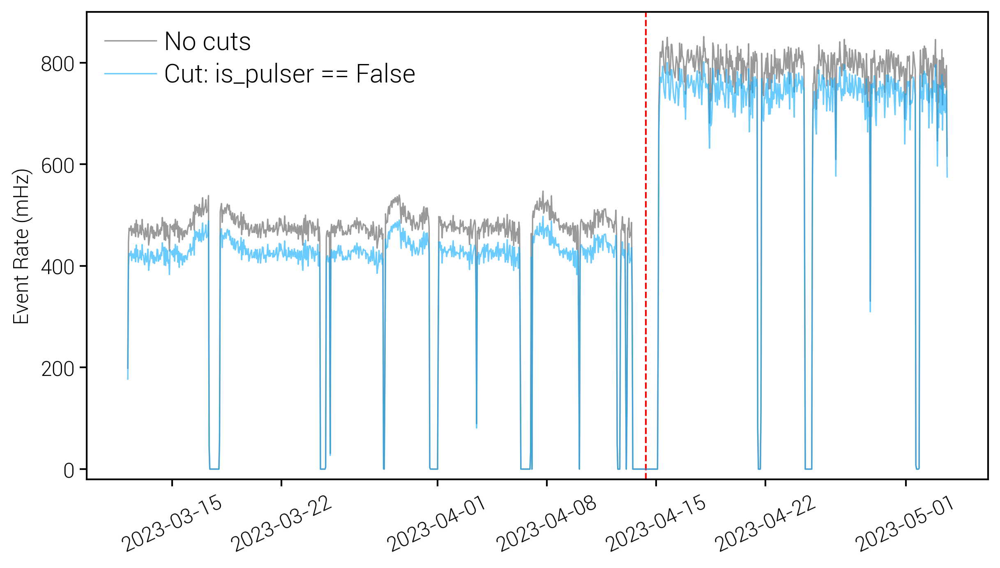

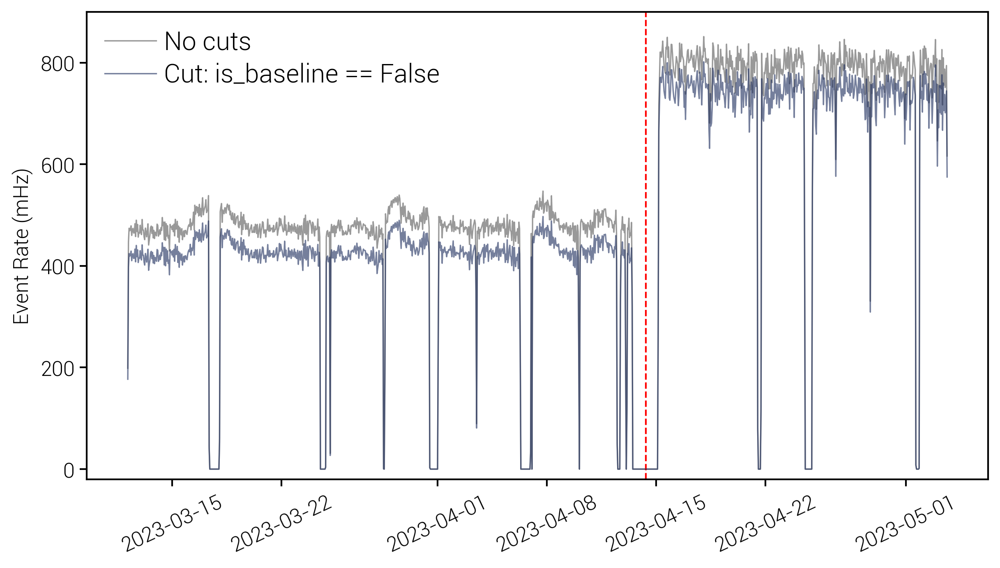

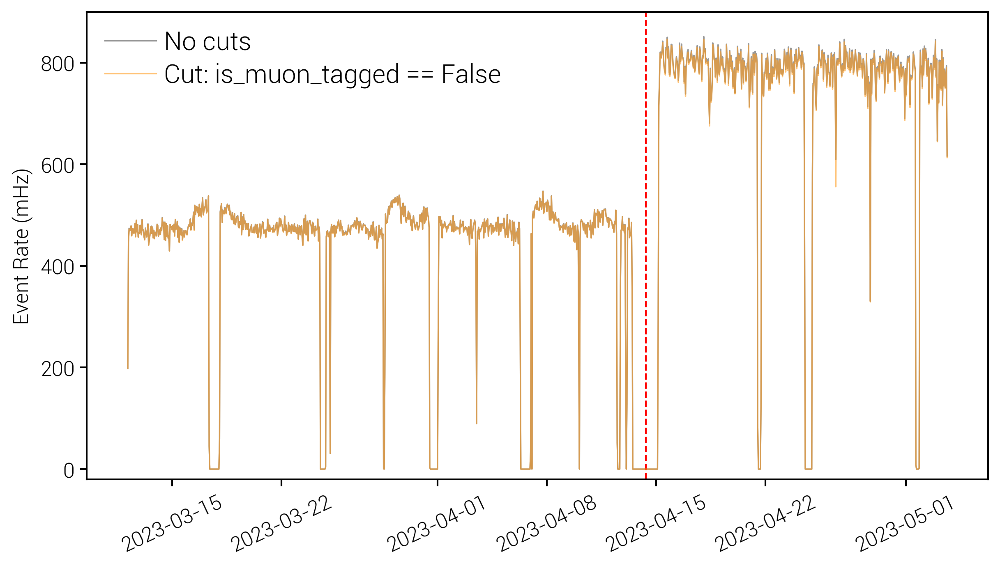

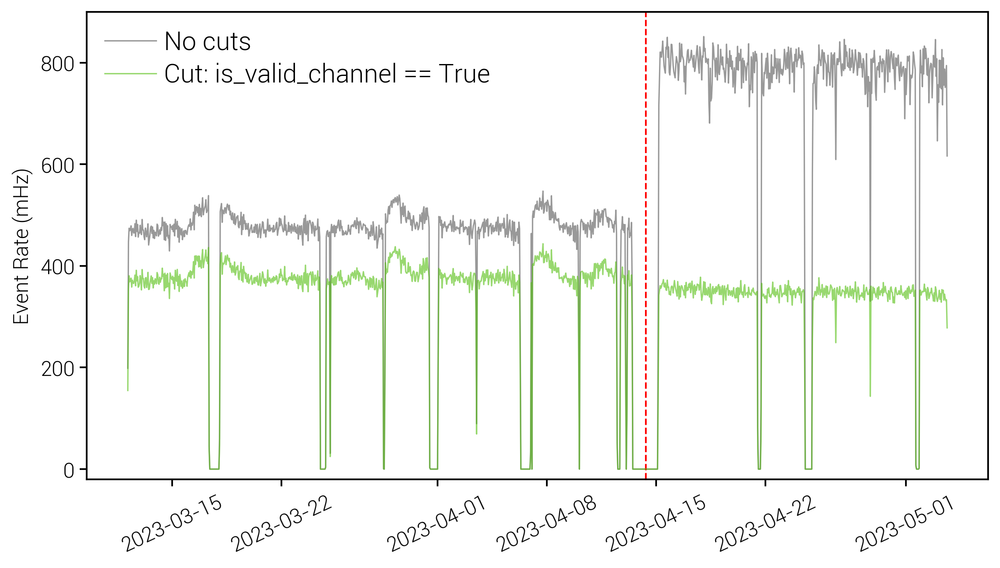

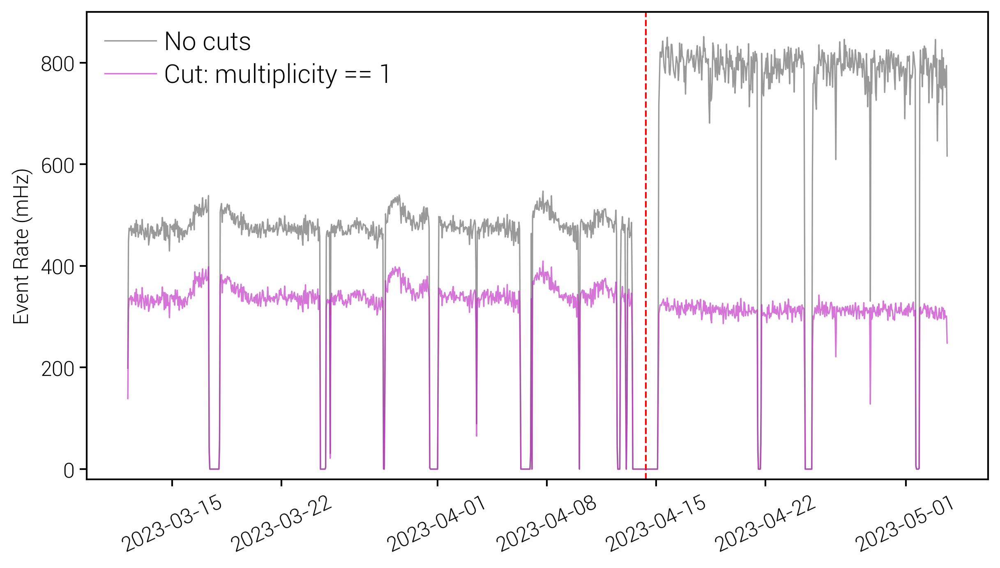

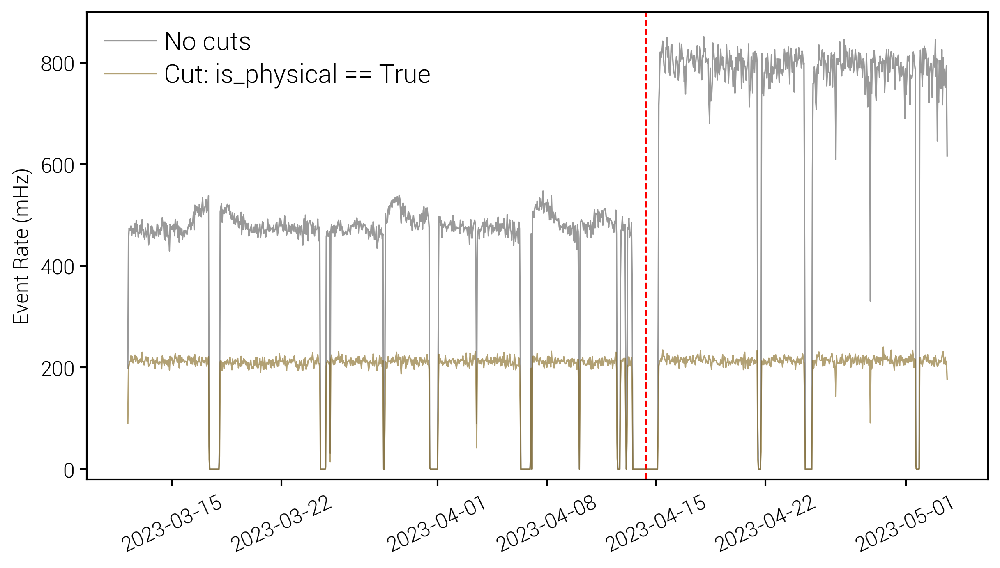

In [18]:
for (cut, val), col in zip(all_cuts, legend_colors[1:]):
    fig, ax = lps.subplots()
    ax.plot(data_series.index, data_series, linewidth=0.8, color='grey', alpha=0.8, label='No cuts')
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')

    df_test        = data[data[cut]==val]
    df_test_series = resample_df(df_test)

    ax.plot(df_test_series.index,  df_test_series,  linewidth=0.8, alpha=0.6, color=lps.colors[col], label=f'Cut: {str(cut)} == {str(val)}')
    ax.set_title(f'')
    ax.set_ylabel('Event Rate (mHz)')
    ax.legend(ncol=1, fontsize=15, loc='upper left')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=25)
    ax.set_ylim(-20, 900)
    plt.show()

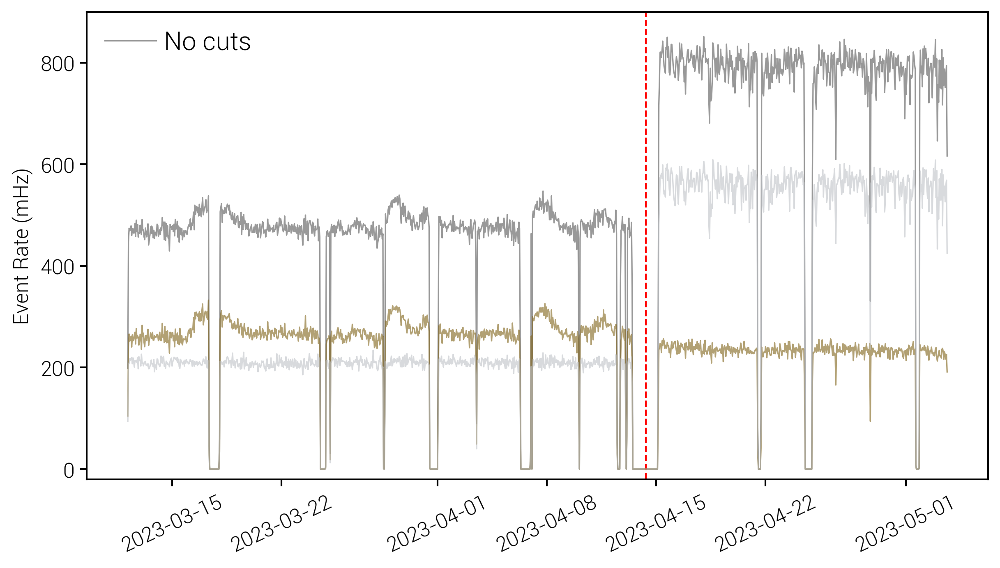

In [19]:
fig, ax = lps.subplots()
ax.plot(data_series.index, data_series, linewidth=0.8, color='grey', alpha=0.8, label='No cuts')
ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')

df_test        = data[data.is_usable_aoe==True]
df_test_series = resample_df(df_test)
df_test2        = data[data.is_usable_aoe==False]
df_test2_series = resample_df(df_test2)

ax.plot(df_test_series .index,  df_test_series,  linewidth=0.8, alpha=0.6, color=lps.colors['legend_gold'])
ax.plot(df_test2_series.index,  df_test2_series, linewidth=0.8, alpha=0.6, color=lps.colors['silver'])
ax.set_title(f'')
ax.set_ylabel('Event Rate (mHz)')
ax.legend(ncol=1, fontsize=15, loc='upper left')
ax.set_xticklabels(ax.get_xticklabels(), rotation=25)
ax.set_ylim(-20, 900)
plt.show()

### Separate with detector types:

In [20]:
nice_det_labels = ['ICPC', 'Coax',   'BEGe', 'PPC']
det_colors      = ['grey', 'yellow', 'red',  'teal']

det_types  = np.array([val[0] for val in channel_dict.values()])
nice_det_name_dict = {'icpc': nice_det_labels[0],
                      'coax': nice_det_labels[1],
                      'bege': nice_det_labels[2],
                      'ppc' : nice_det_labels[3]}

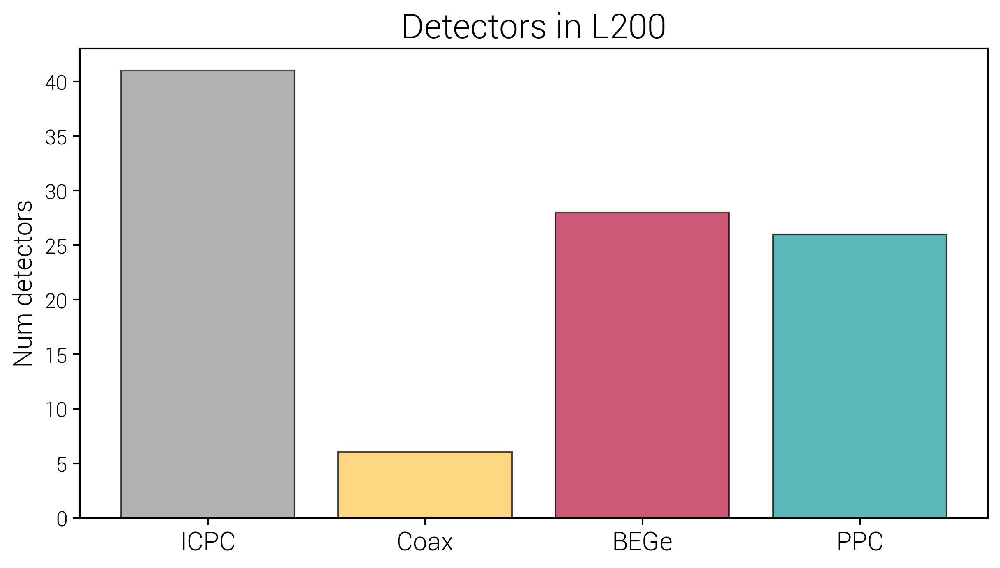

In [21]:
fig, ax = lps.subplots()
for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    d_vals = det_types[det_types==d_type]
    plt.hist(d_vals, bins=np.arange(-0.5, 4.5, 1), align='mid', rwidth=0.8, alpha=0.7, color=lps.colors[col], edgecolor='black')
#xlabels = 
plt.xticks(np.arange(4), nice_det_labels, fontsize=15)  # Centered ticks
plt.title('Detectors in L200', fontsize=20)
plt.ylabel('Num detectors', fontsize=15)
plt.show()

In [22]:
data_filt.det_type.unique()

array(['icpc', 'ppc', 'coax', 'bege'], dtype=object)

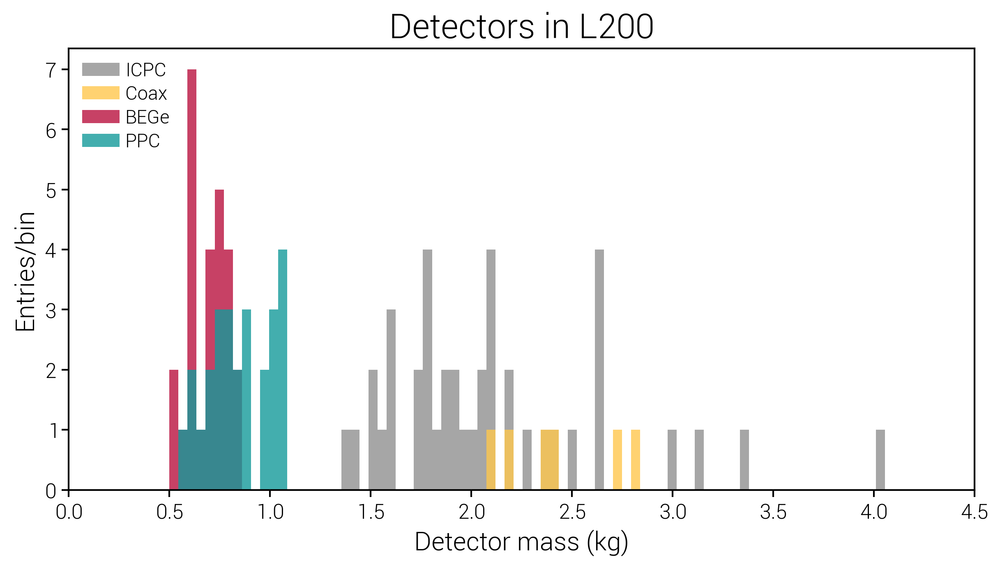

In [23]:
fig, ax = lps.subplots()
for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    d_mass = []
    det_lab = nice_det_name_dict[d_type]
    for val in channel_dict.values():
        if val[0]==d_type:
            d_mass.append(val[2])
    plt.hist(np.array(d_mass)/1000, bins=80, range=(0.5, 4.1), label=f'{det_lab}', alpha=0.8, color=lps.colors[col])
    plt.title('Detectors in L200',   fontsize=20)
    plt.xlabel('Detector mass (kg)', fontsize=15)
    plt.ylabel('Entries/bin',        fontsize=15)
    plt.xlim(0, 4.5)
    plt.legend();

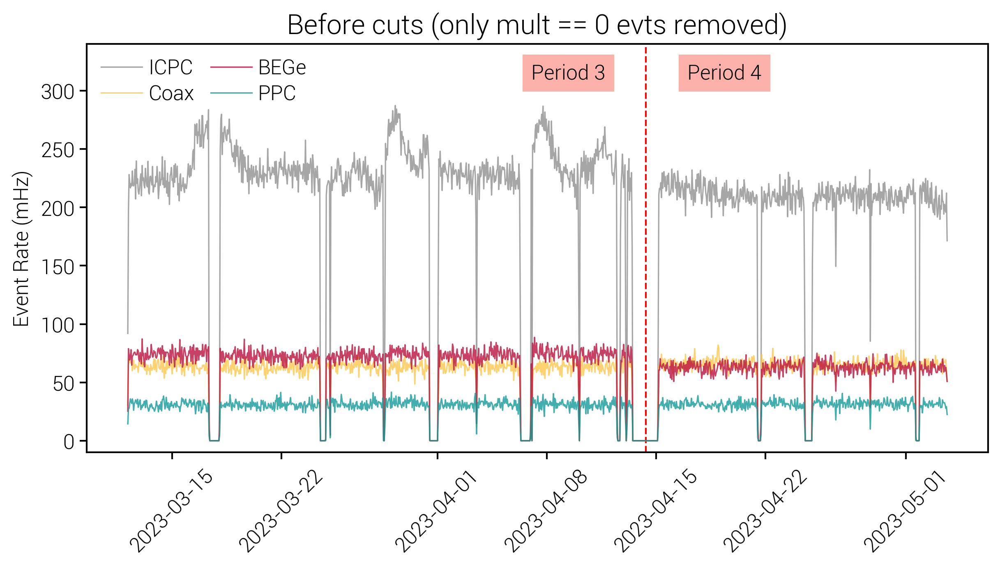

In [24]:
fig, ax = lps.subplots()

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 310, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 310, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    det_lab         = nice_det_name_dict[d_type]
    data_det        = data[data.det_type==d_type]
    data_det_series = resample_df(data_det)
    plt.plot(data_det_series.index, data_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
plt.title('Before cuts (only mult == 0 evts removed)', fontsize=16)
plt.ylabel('Event Rate (mHz)')
plt.legend(loc=2, ncol=2, fontsize=12)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-10, 340)
plt.show()

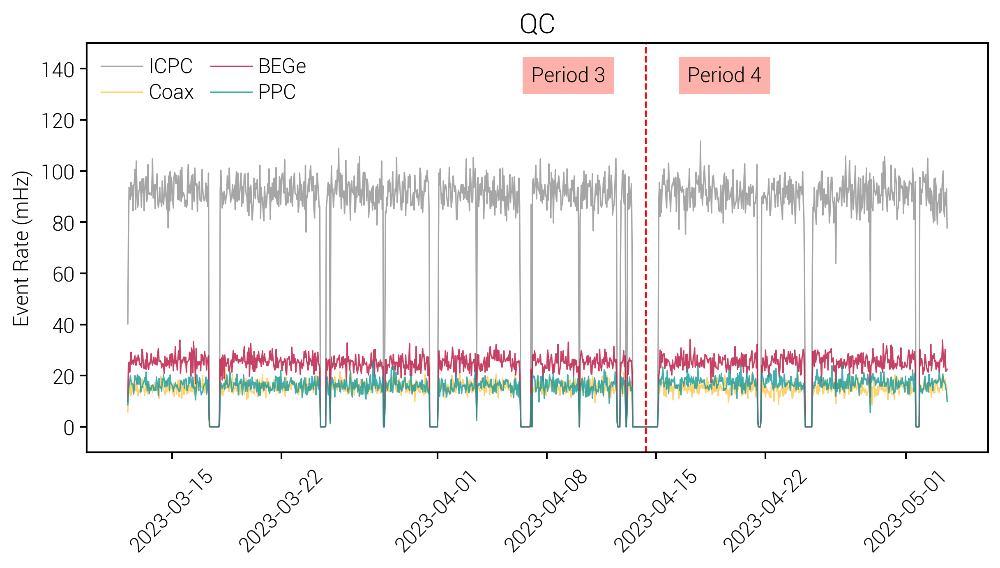

In [25]:
fig, ax = lps.subplots()

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 135, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 135, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    det_lab              = nice_det_name_dict[d_type]
    data_filt_det        = data_filt[data_filt.det_type==d_type]
    data_filt_det_series = resample_df(data_filt_det)
    plt.plot(data_filt_det_series.index, data_filt_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
plt.title('QC', fontsize=16)
plt.ylabel('Event Rate (mHz)')
plt.legend(loc=2, ncol=2, fontsize=12)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-10, 150)
plt.show()

In [80]:
nice_det_name_dict.keys()

dict_keys(['icpc', 'coax', 'bege', 'ppc'])

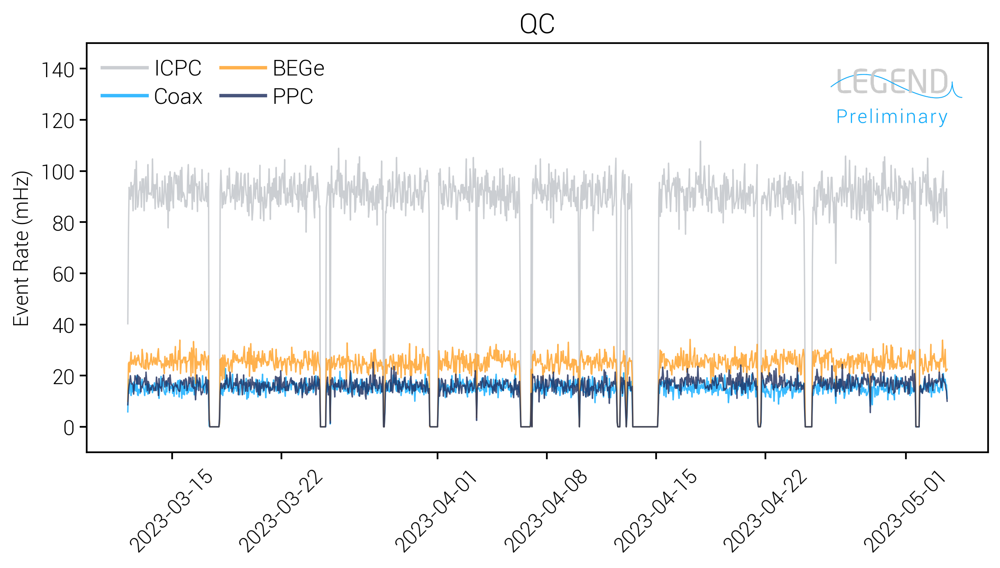

In [89]:
fig, ax = lps.subplots()
det_colors_leg_style = ['silver', 'legend_blue', 'legend_orange', 'legend_darkblue']
for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
    det_lab              = nice_det_name_dict[d_type]
    data_filt_det        = data_filt[data_filt.det_type==d_type]
    data_filt_det_series = resample_df(data_filt_det)
    ax.plot(data_filt_det_series.index, data_filt_det_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title('QC', fontsize=16)
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=2, fontsize=13, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-10, 150)
plt.show()

### Event rate normalized to detector mass

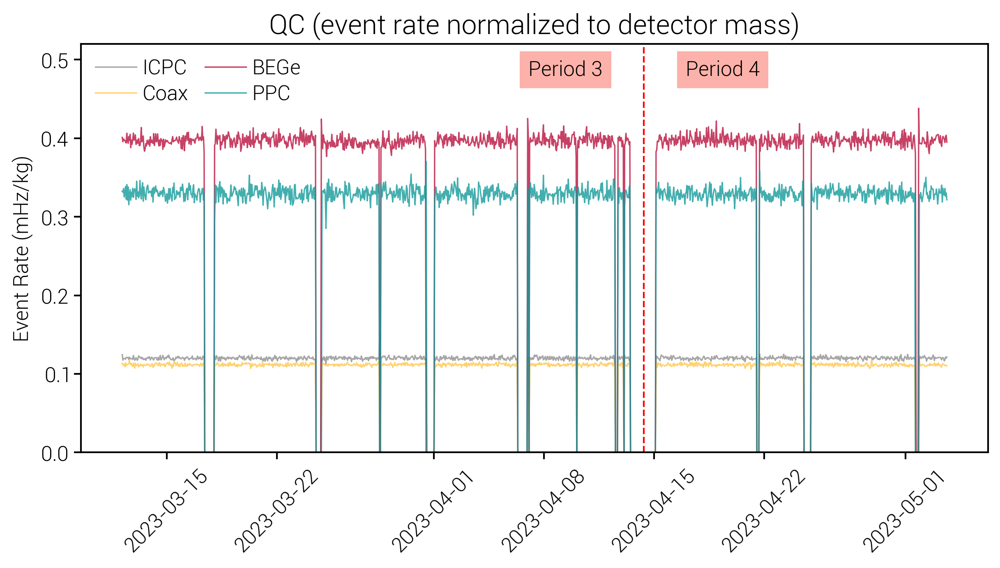

In [26]:
fig, ax = lps.subplots()

plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
plt.text(pd.to_datetime('2023-04-07'), 0.48, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
plt.text(pd.to_datetime('2023-04-17'), 0.48, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))

for d_type, col in zip(nice_det_name_dict.keys(), det_colors):
    det_lab              = nice_det_name_dict[d_type]
    data_filt_det        = data_filt[data_filt.det_type==d_type]
    data_filt_det_mass_series = resample_df_norm_mass(data_filt_det)
    plt.plot(data_filt_det_mass_series.index, data_filt_det_mass_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
plt.title('QC (event rate normalized to detector mass)', fontsize=16)
plt.ylabel('Event Rate (mHz/kg)')

plt.legend(loc=2, ncol=2, fontsize=12)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(0., 0.52)
plt.show()

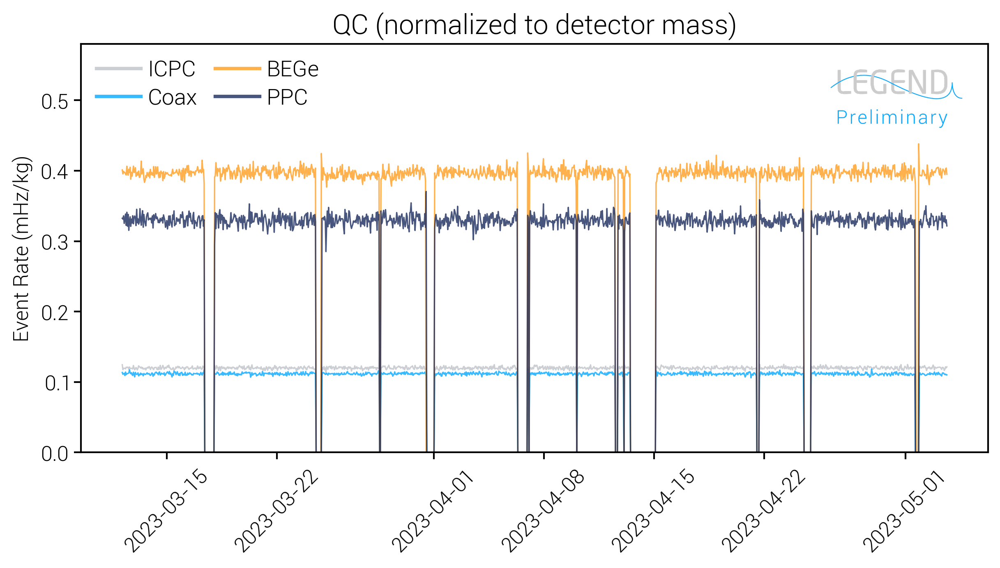

In [90]:
fig, ax = lps.subplots()
for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
    det_lab              = nice_det_name_dict[d_type]
    data_filt_det        = data_filt[data_filt.det_type==d_type]
    data_filt_det_mass_series = resample_df_norm_mass(data_filt_det)
    ax.plot(data_filt_det_mass_series.index, data_filt_det_mass_series, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
plt.title('QC (normalized to detector mass)', fontsize=16)
plt.ylabel('Event Rate (mHz/kg)')

leg = ax.legend(ncol=2, fontsize=13, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(0., 0.58)
plt.show()

### Individual cuts to every detector type

--------------------------ICPC----------------------------


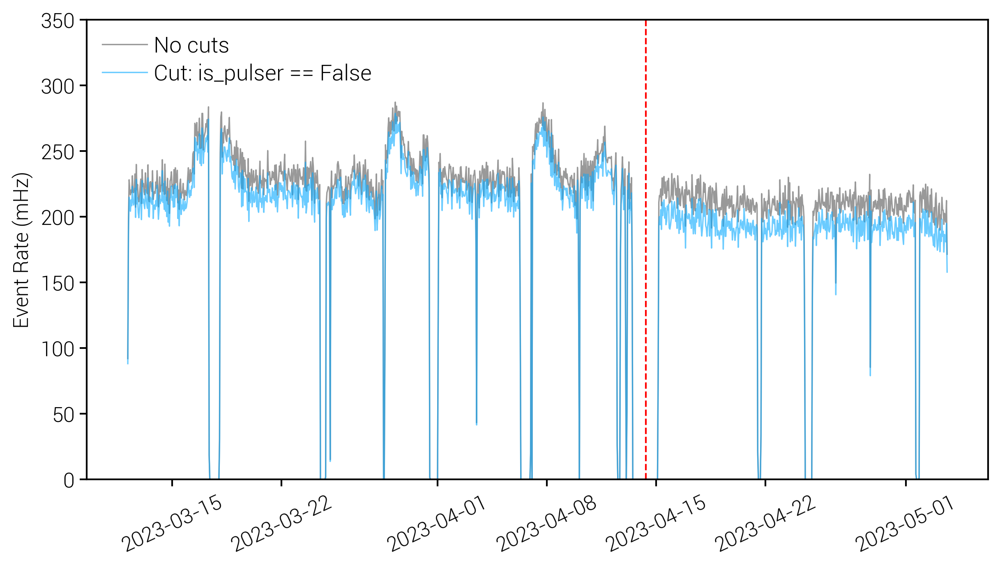

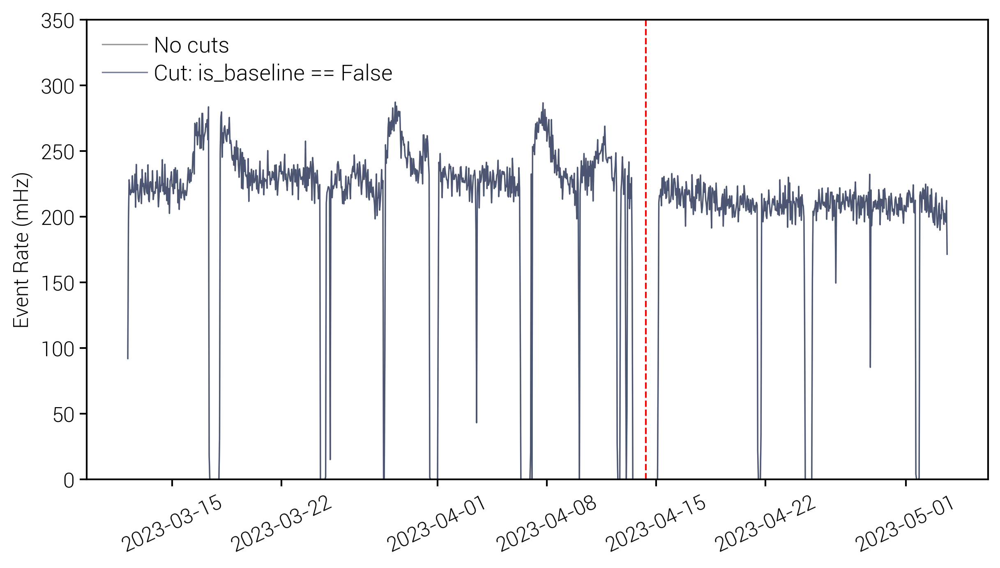

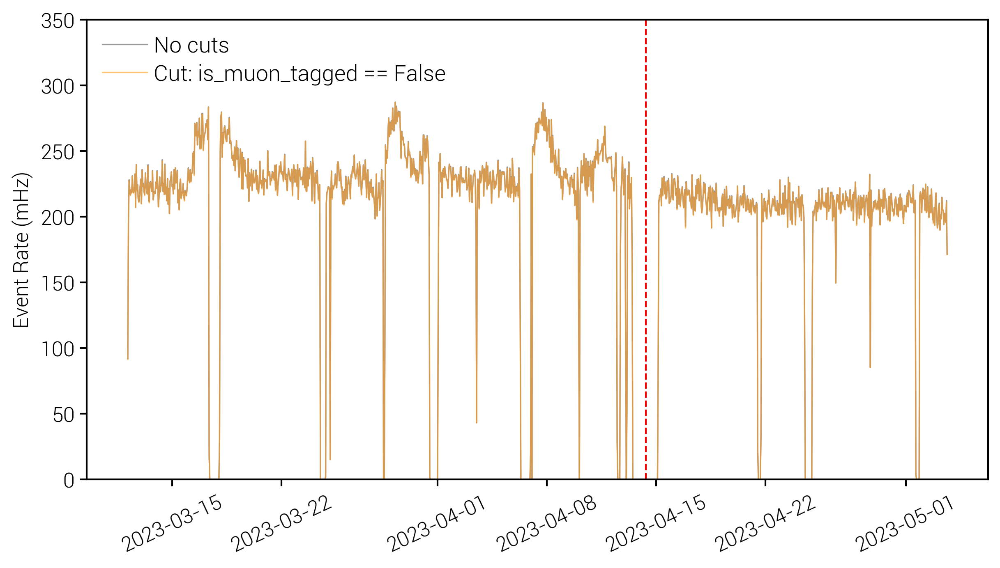

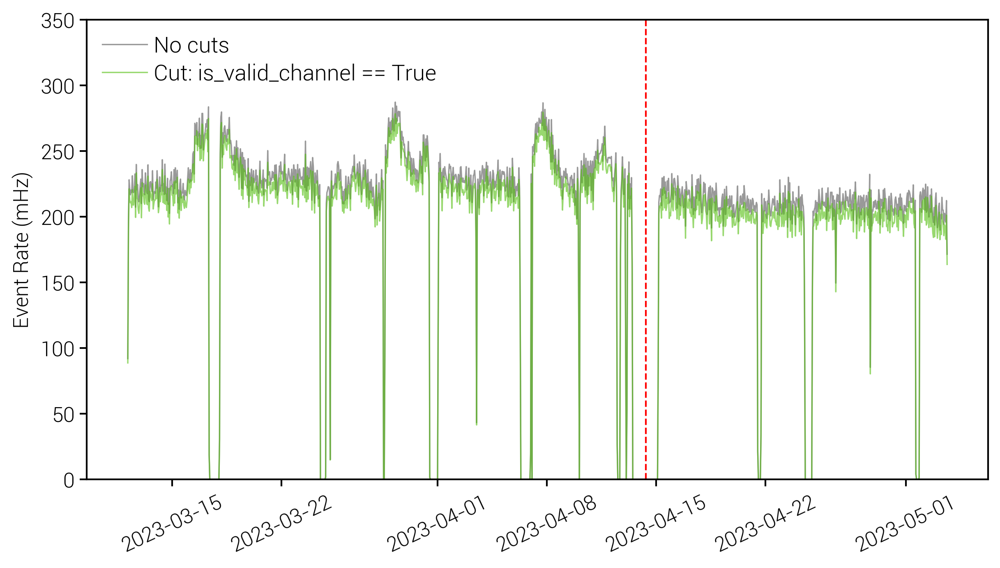

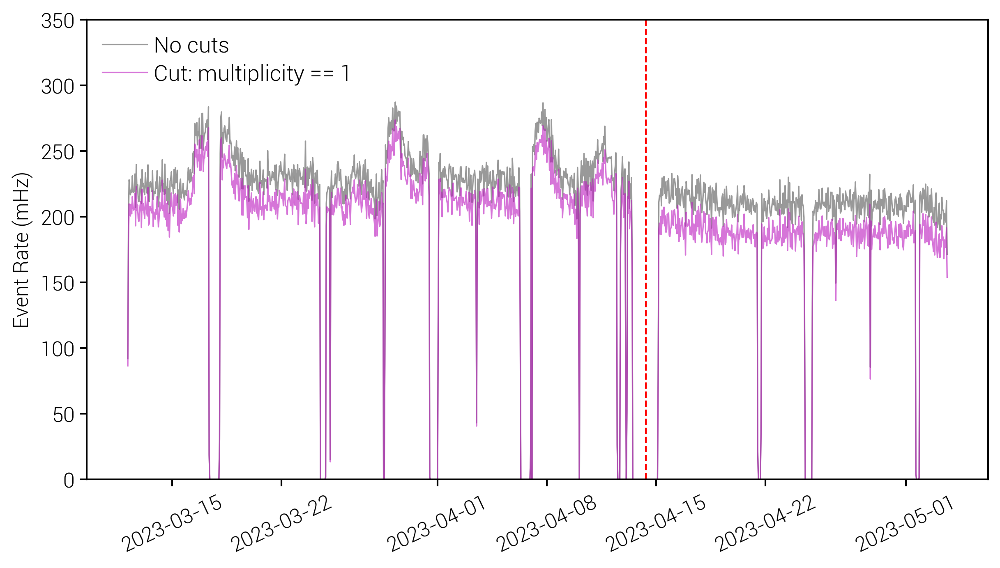

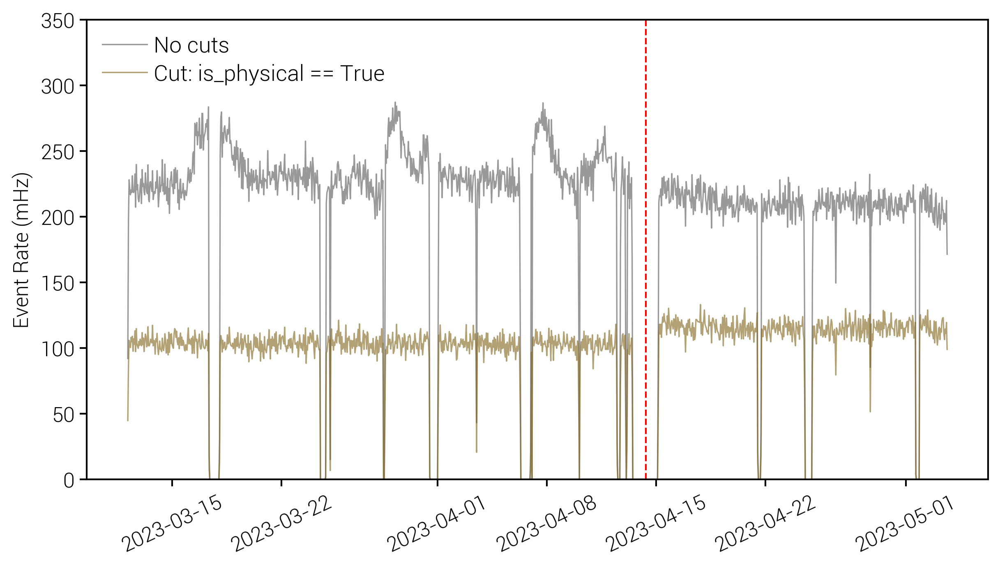

--------------------------Coax----------------------------


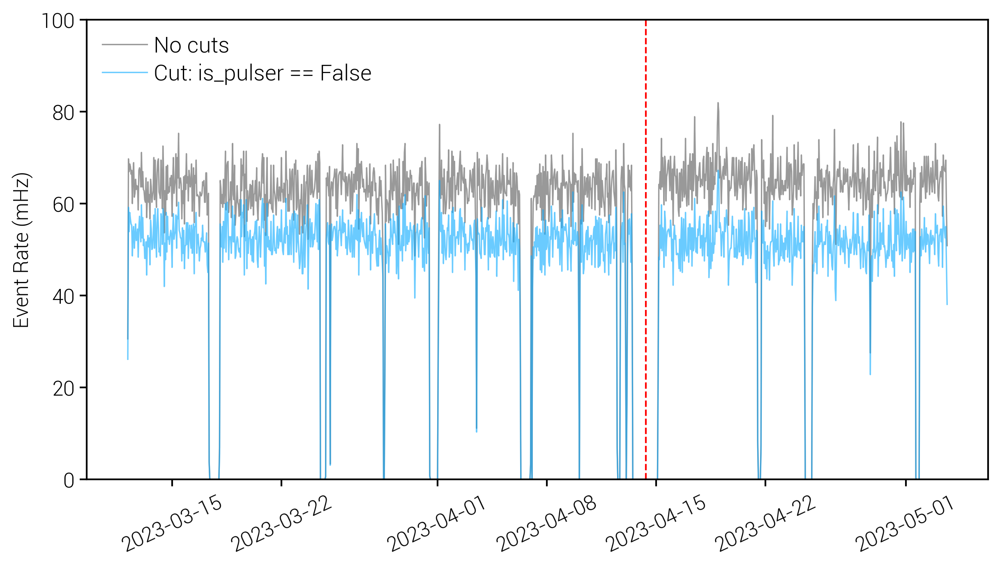

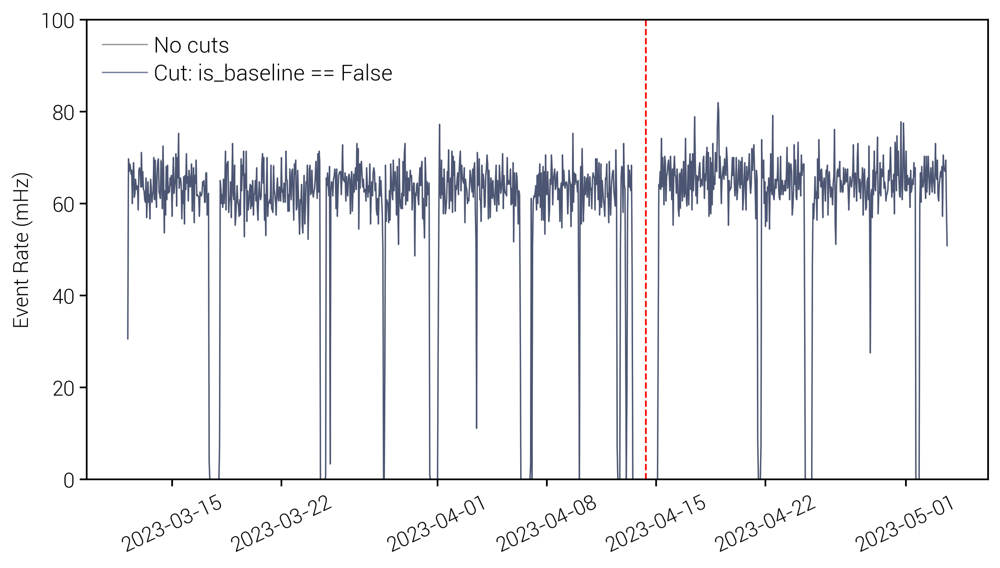

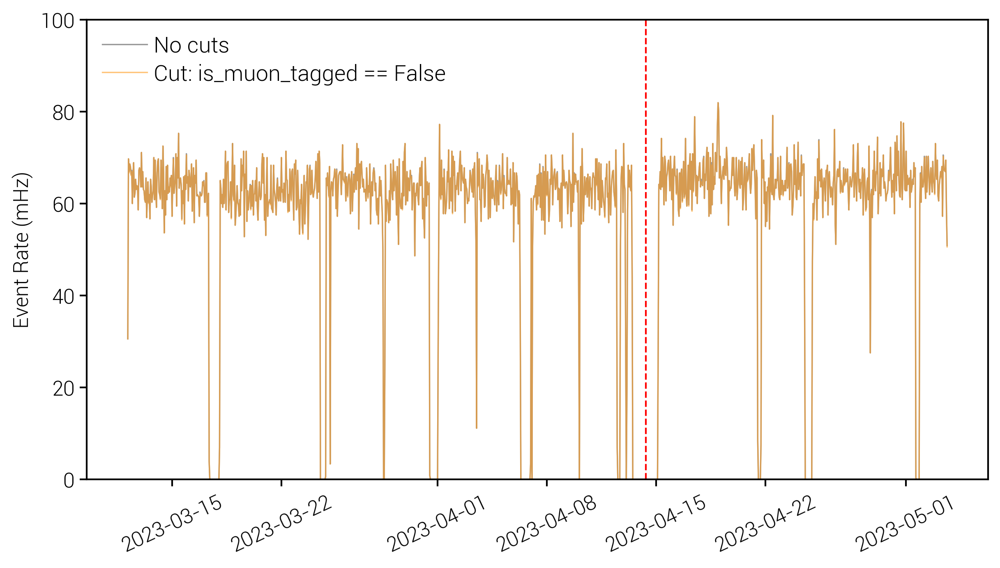

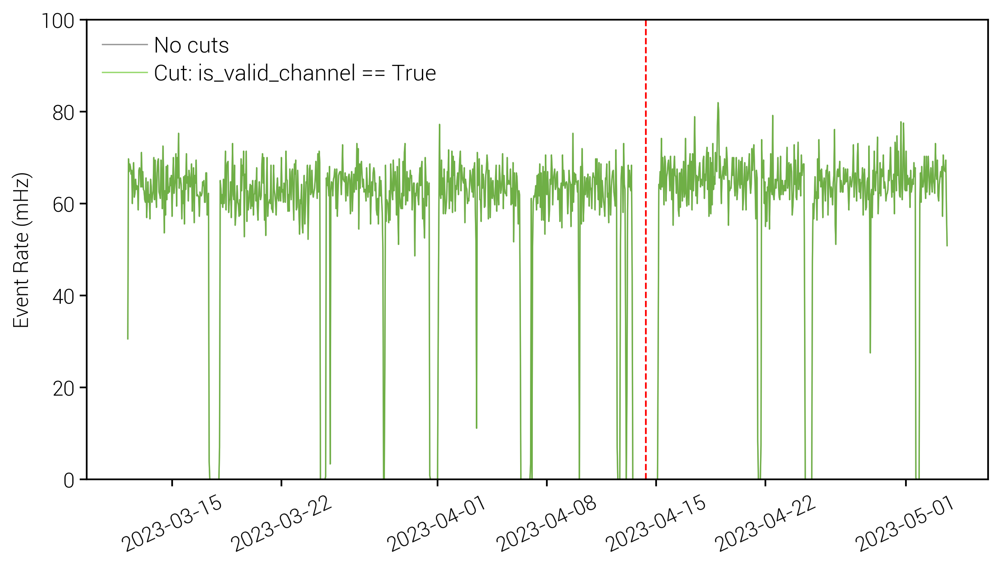

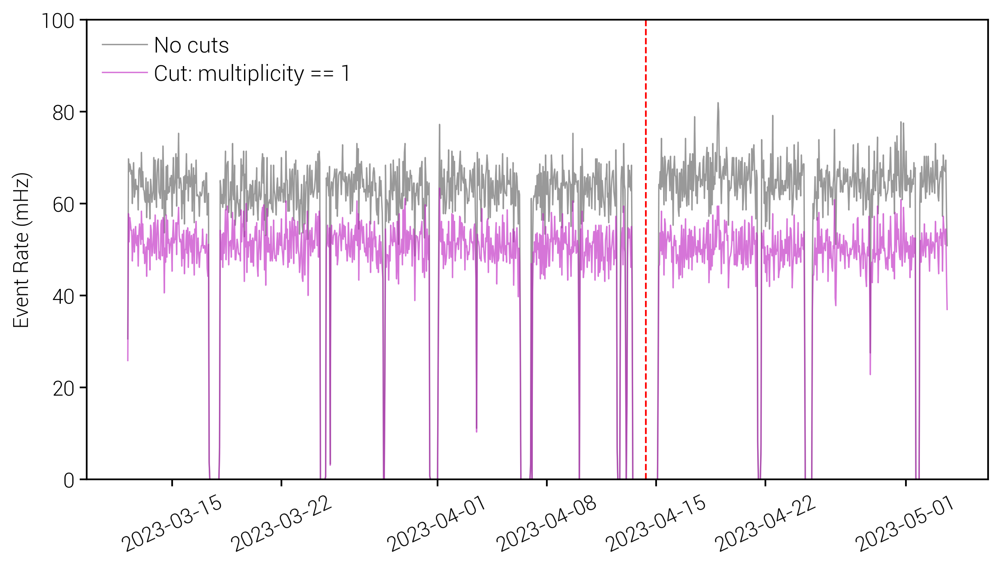

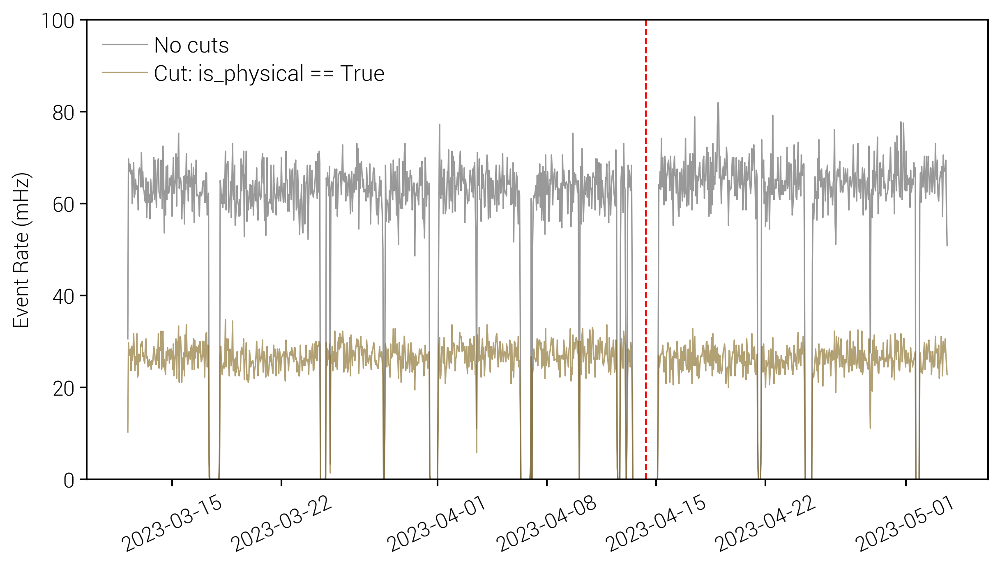

--------------------------BEGe----------------------------


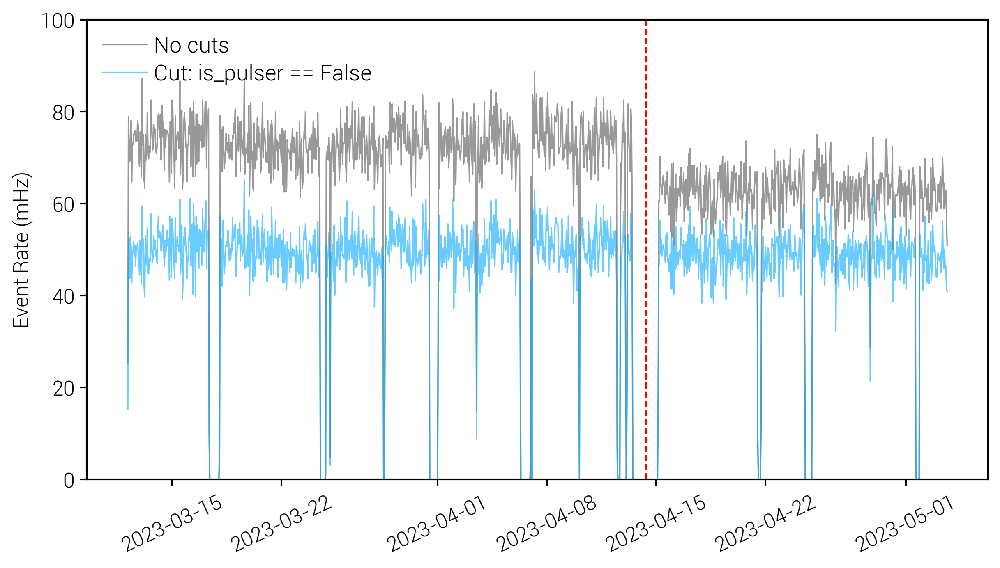

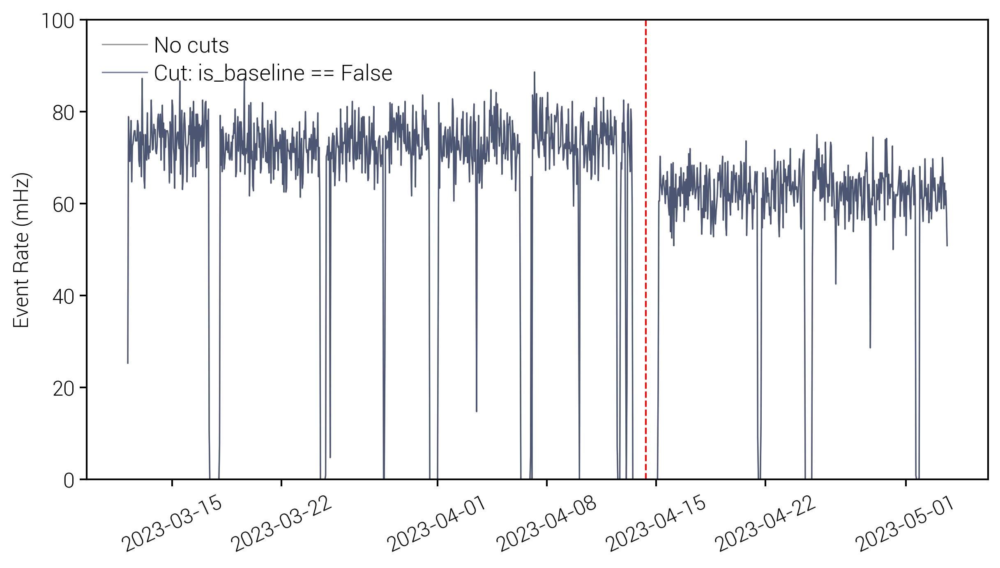

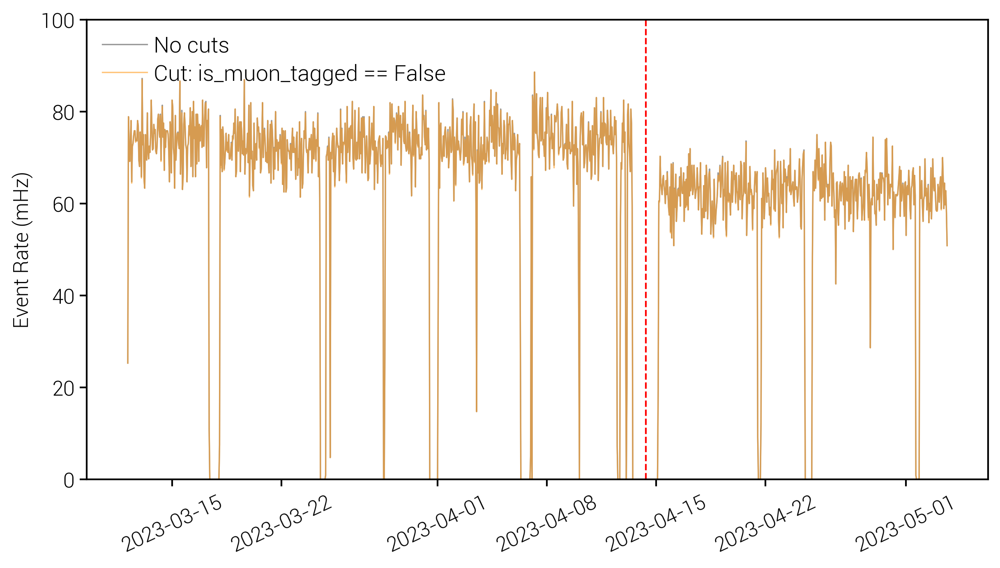

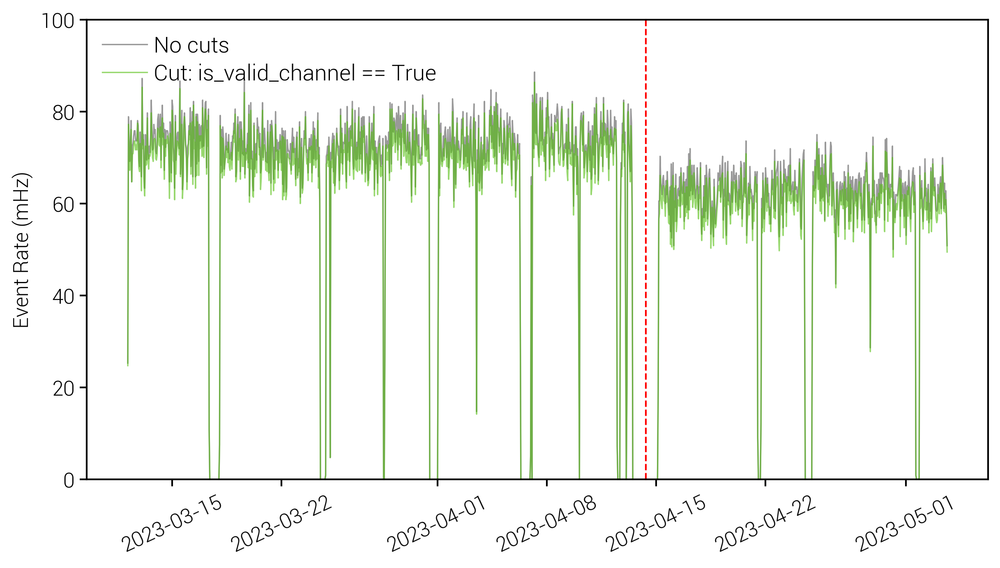

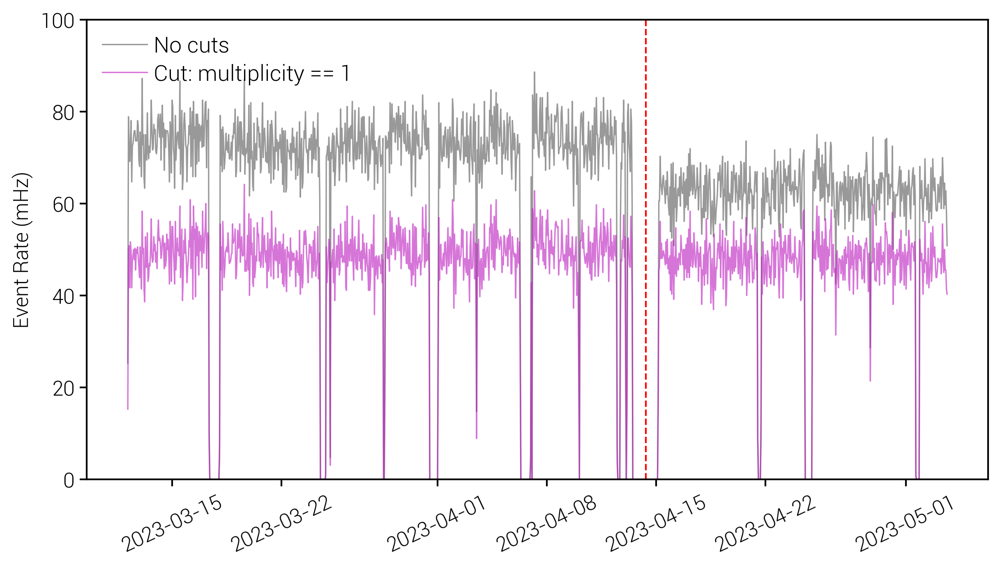

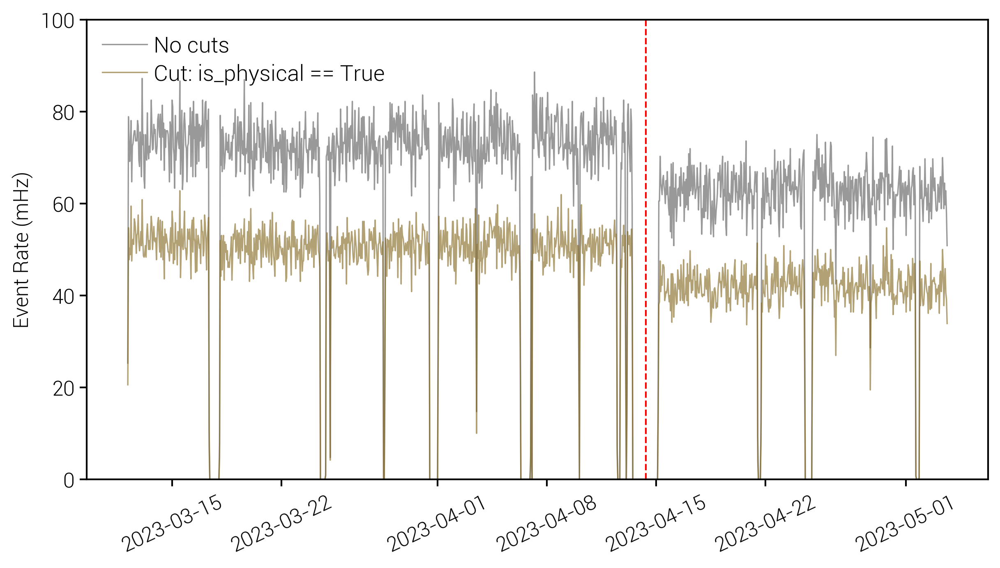

--------------------------PPC----------------------------


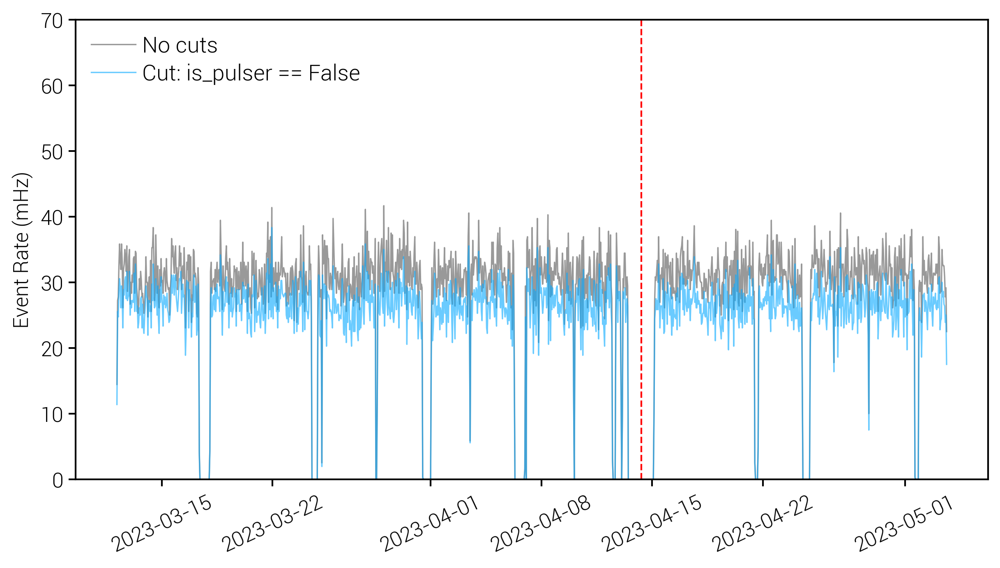

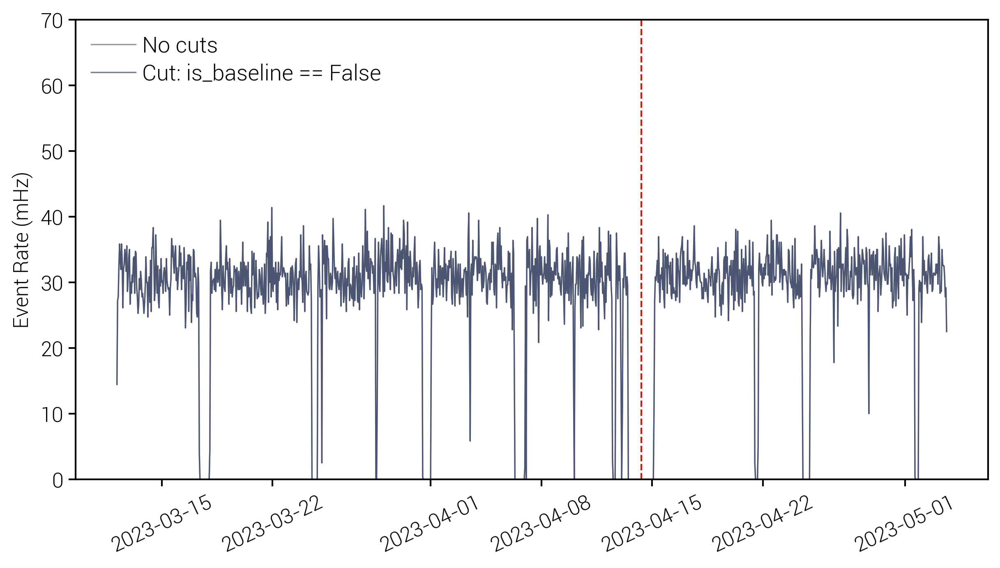

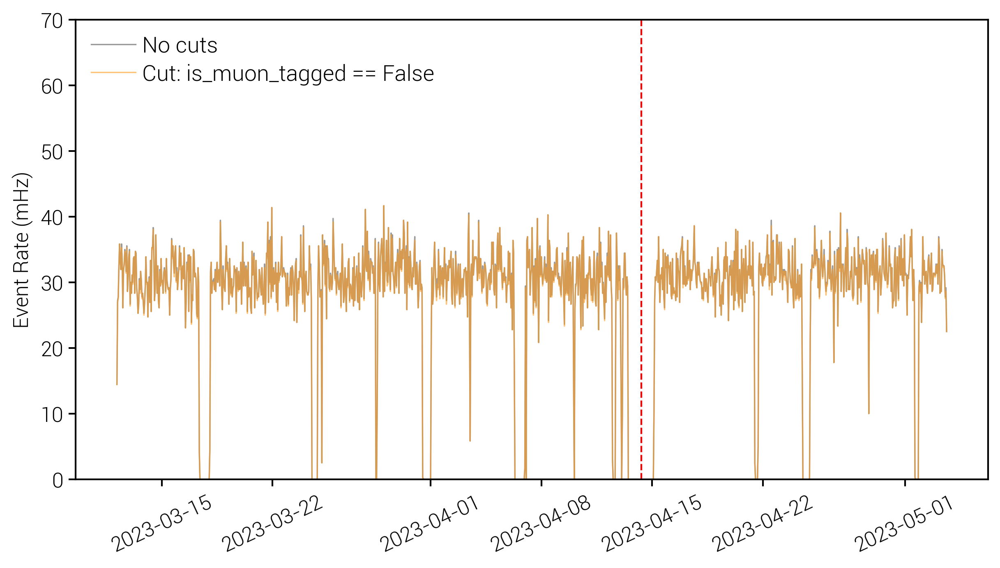

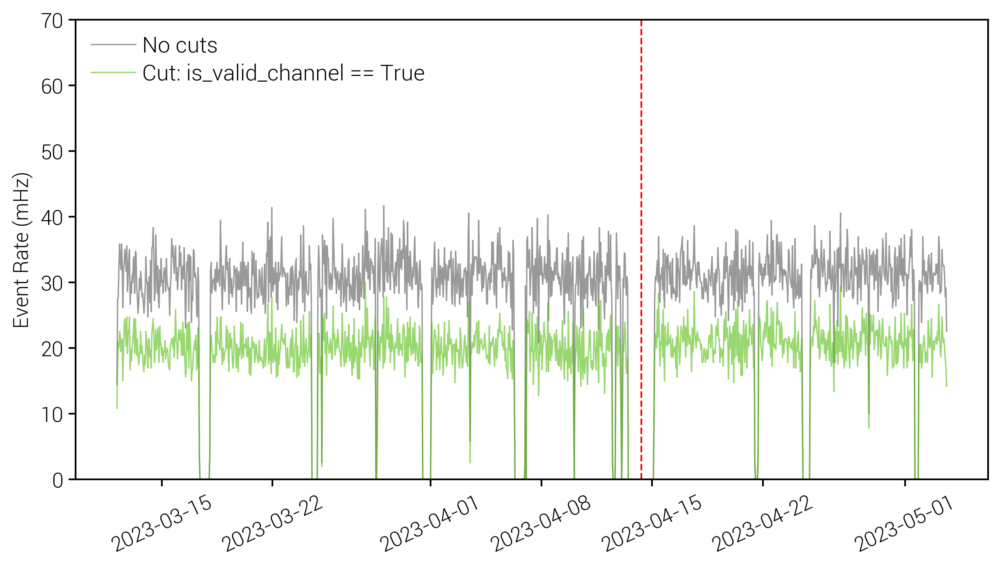

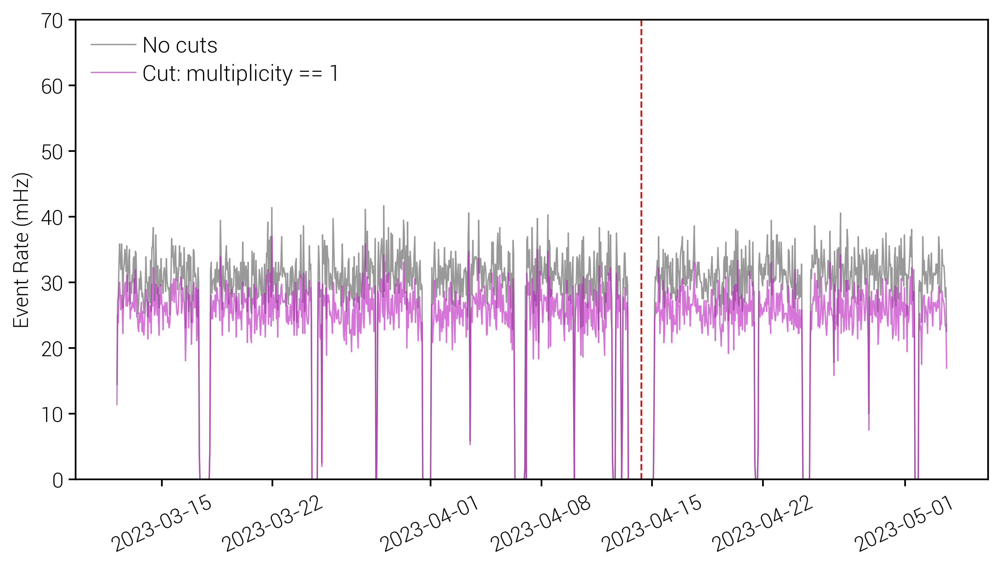

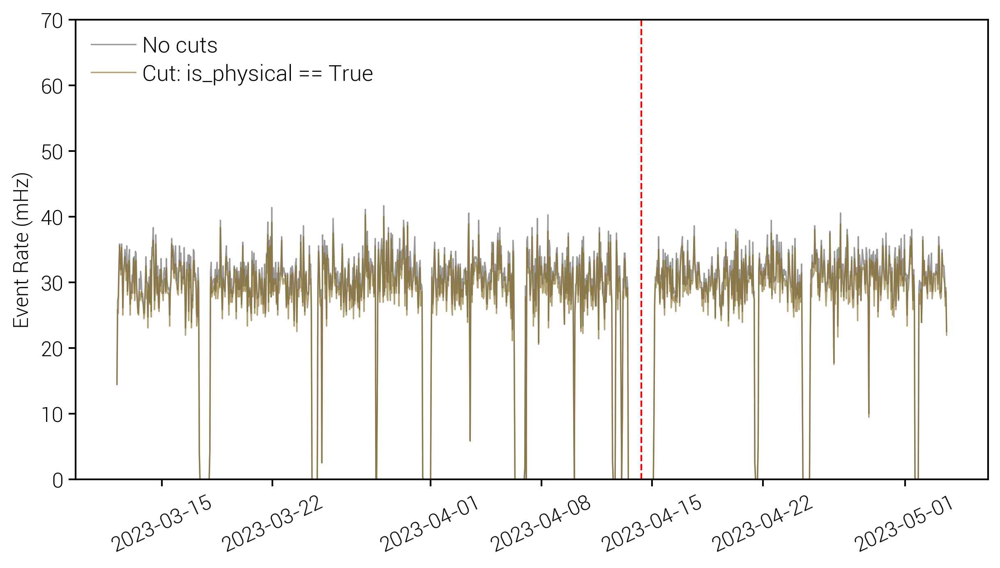

In [27]:
yranges = [(0, 350), (0, 100), (0, 100), (0, 70)]
for i, (d_type, yr) in enumerate(zip(nice_det_name_dict.keys(), yranges)):
    det_lab         = nice_det_name_dict[d_type]
    print(f'--------------------------{det_lab}----------------------------')
    data_det        = data[data.det_type==d_type]
    data_det_series = resample_df(data_det)    
    for (cut, val), col in zip(all_cuts, legend_colors[1:]):
        fig, ax = lps.subplots()
        ax.plot(data_det_series.index, data_det_series, linewidth=0.8, color='grey', alpha=0.8, label='No cuts')
        ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
        df_test        = data_det[data_det[cut]==val]
        df_test_series = resample_df(df_test)

        ax.plot(df_test_series.index, df_test_series, linewidth=0.8, alpha=0.6, color=lps.colors[col], label=f'Cut: {str(cut)} == {str(val)}')
        ax.set_title(f'')
        ax.set_ylabel('Event Rate (mHz)')
        ax.legend(ncol=1, fontsize=13, loc='upper left')
        ax.set_xticklabels(ax.get_xticklabels(), rotation=25)
        ax.set_ylim(yr)
        plt.show()


### Energy

In [121]:
energy_ranges = [(200,600), (900,1300), (1400,1600), (1900,2500), (2550,2700), (4500,5500)]
energy_colors = ['violet', 'red', 'legend_blue', 'teal', 'legend_darkblue', 'yellow']

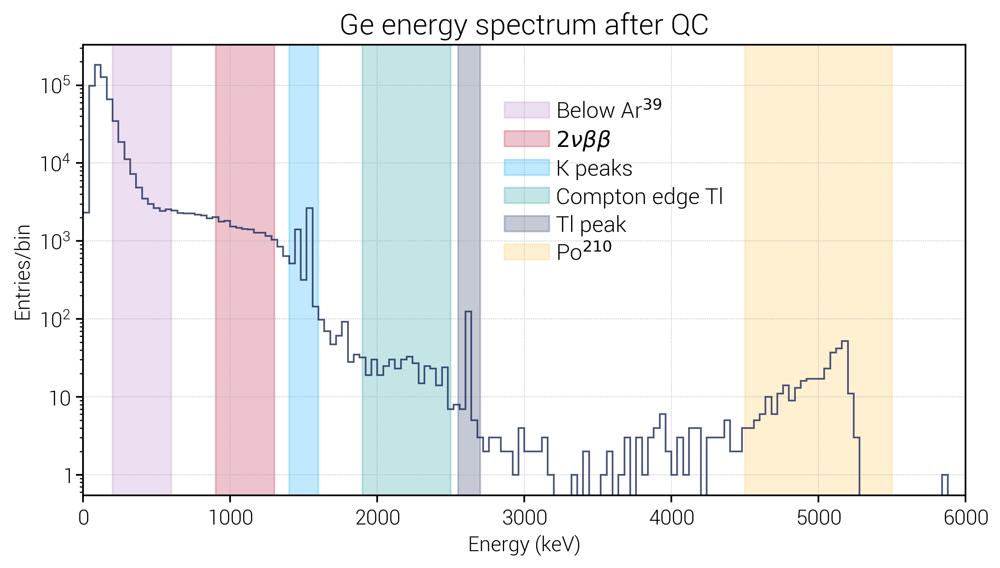

In [137]:
fig, ax = lps.subplots()
data_filt.energy.hist(bins=150, range=(0, 6000), log=True, alpha=0.8, histtype='step', color=lps.colors['legend_darkblue'])
plt.axvspan(energy_ranges[0][0], energy_ranges[0][1], label=r'Below Ar$^{39}$',  color=lps.colors[energy_colors[0]], alpha=0.25)
plt.axvspan(energy_ranges[1][0], energy_ranges[1][1], label=r'$2\nu\beta\beta$', color=lps.colors[energy_colors[1]], alpha=0.25)
plt.axvspan(energy_ranges[2][0], energy_ranges[2][1], label='K peaks'          , color=lps.colors[energy_colors[2]], alpha=0.25)
plt.axvspan(energy_ranges[3][0], energy_ranges[3][1], label='Compton edge Tl'  , color=lps.colors[energy_colors[3]], alpha=0.25)
plt.axvspan(energy_ranges[4][0], energy_ranges[4][1], label='Tl peak'          , color=lps.colors[energy_colors[4]], alpha=0.25)
plt.axvspan(energy_ranges[5][0], energy_ranges[5][1], label=r'Po$^{210}$'      , color=lps.colors[energy_colors[5]], alpha=0.25)
plt.title('Ge energy spectrum after QC', fontsize=17)
plt.xlabel('Energy (keV)')
plt.ylabel('Entries/bin')
plt.legend(bbox_to_anchor=(0.46, 0.91), fontsize=13)
plt.xlim(0, 6000)
plt.show()

In [107]:
def evt_arte_energy_cuts(df, e1, e2, timest='1H'):
    df_e = df[(df.energy>e1)&(df.energy<=e2)]
    df_e_series = resample_df(df_e, timest)
    return df_e_series

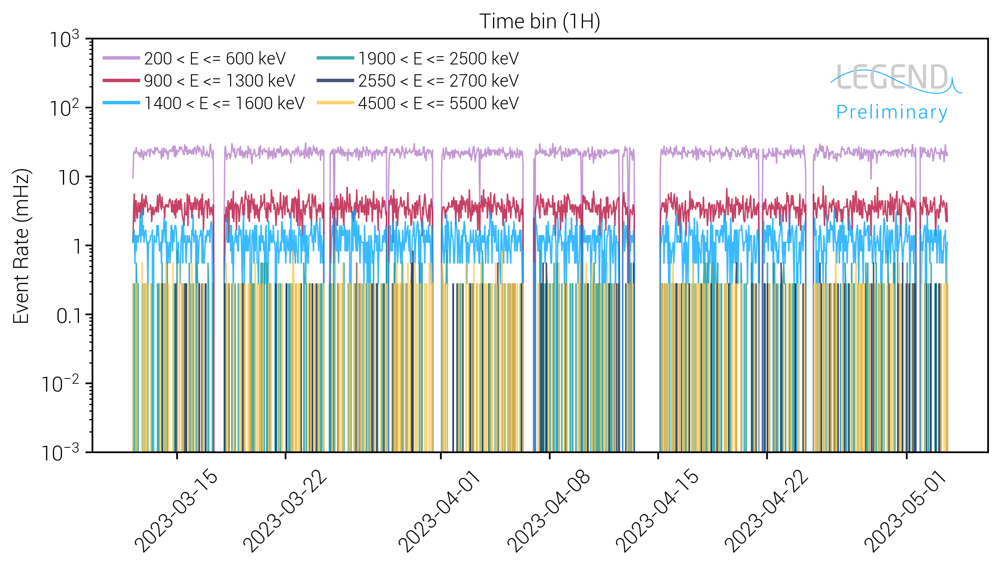

In [144]:
timestamp = '1H'

fig, ax = lps.subplots()
#plt.axvline(x=vert_line_num, color='red', linestyle='--', label='')
#plt.text(pd.to_datetime('2023-04-07'), 1000, 'Period 3', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
#plt.text(pd.to_datetime('2023-04-17'), 1000, 'Period 4', bbox=dict(facecolor='salmon', edgecolor='none', pad=5, alpha=0.6))
for (e1, e2), col in zip(energy_ranges, energy_colors):
    data_filt_e_sr = evt_arte_energy_cuts(data_filt, e1, e2, timest=timestamp)
    ax.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title(f'Time bin ({timestamp})')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=2, fontsize=10, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(10**(-3), 10**3)
#plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
plt.yscale('log')
plt.show()

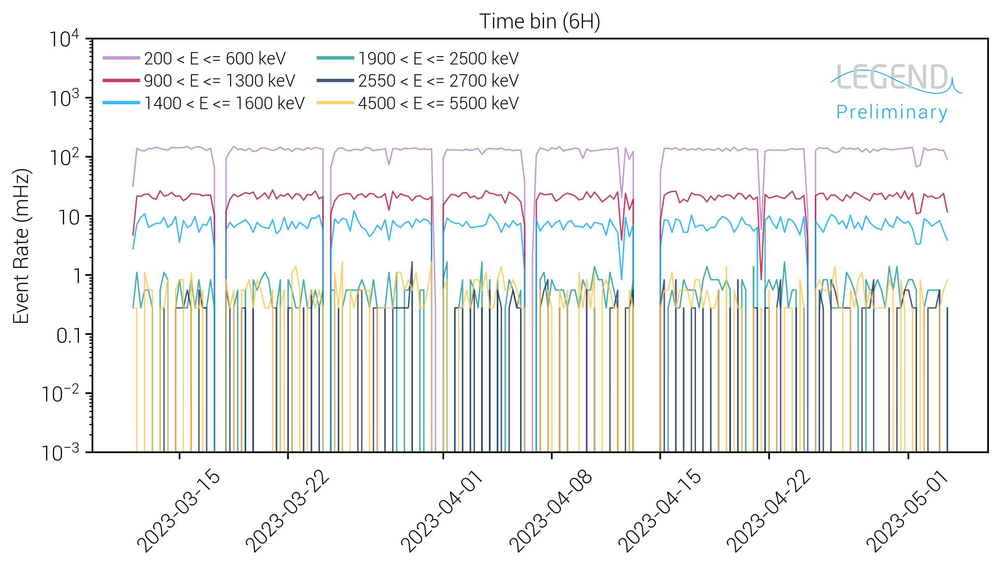

In [145]:
timestamp = '6H'

fig, ax = lps.subplots()
for (e1, e2), col in zip(energy_ranges, energy_colors):
    data_filt_e_sr = evt_arte_energy_cuts(data_filt, e1, e2, timest=timestamp)
    ax.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title(f'Time bin ({timestamp})')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=2, fontsize=10, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(10**(-3), 10**4)
#plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
plt.yscale('log')
plt.show()

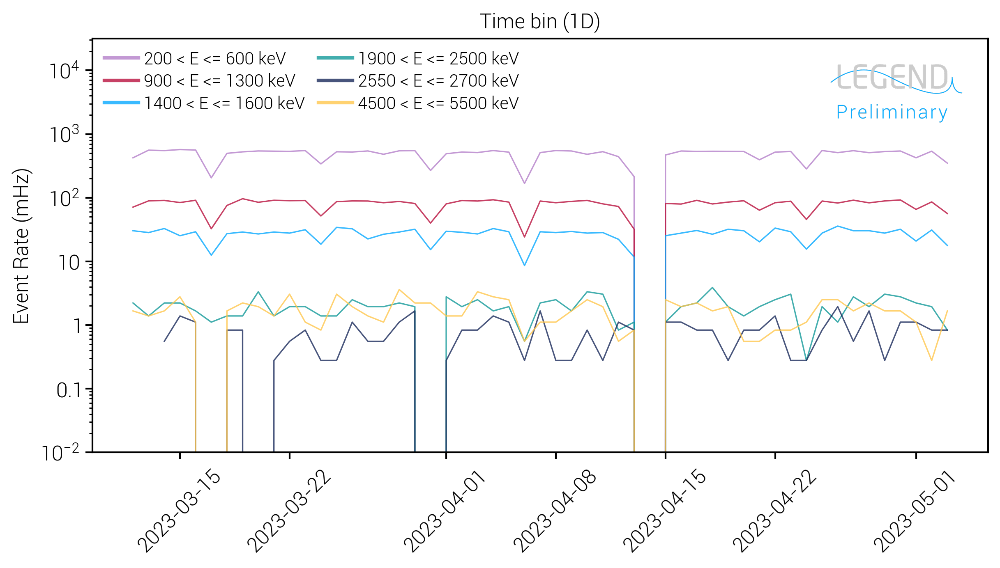

In [146]:
timestamp = '1D'

fig, ax = lps.subplots()
for (e1, e2), col in zip(energy_ranges, energy_colors):
    data_filt_e_sr = evt_arte_energy_cuts(data_filt, e1, e2, timest=timestamp)
    ax.plot(data_filt_e_sr.index, data_filt_e_sr, linewidth=0.8, color=lps.colors[col], alpha=0.8, label=f'{e1} < E <= {e2} keV')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title(f'Time bin ({timestamp})')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=2, fontsize=10, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(10**(-2), 10**4.5)
#plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
plt.yscale('log')
plt.show()

### Separate energy regions and detector types:

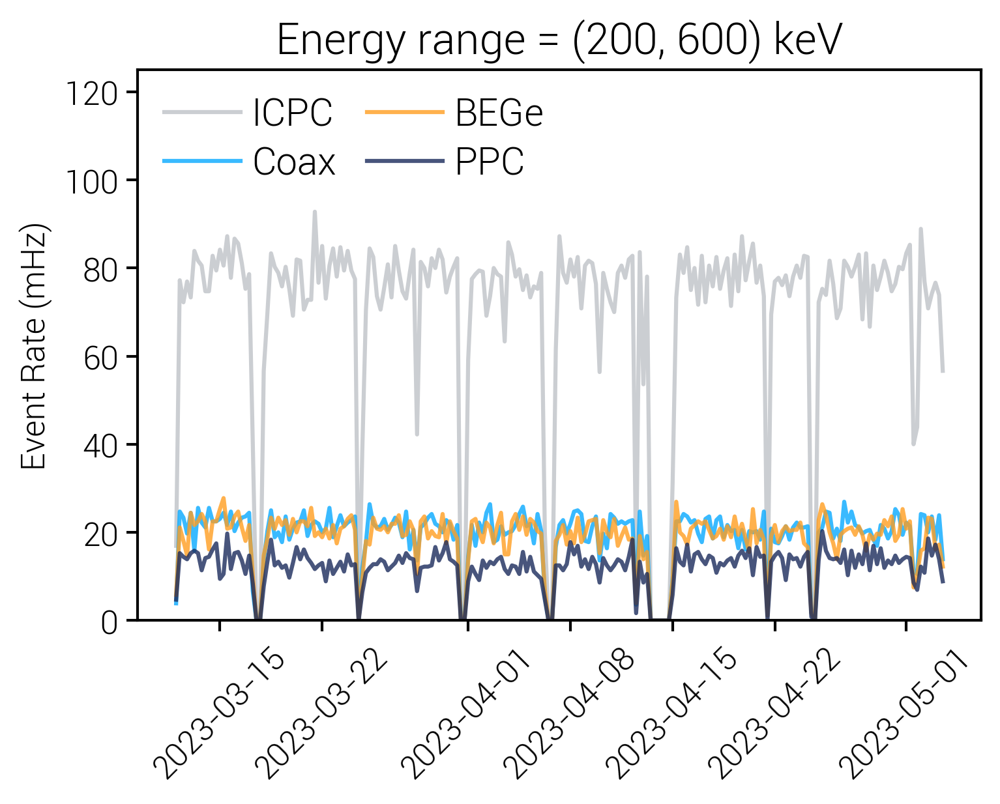

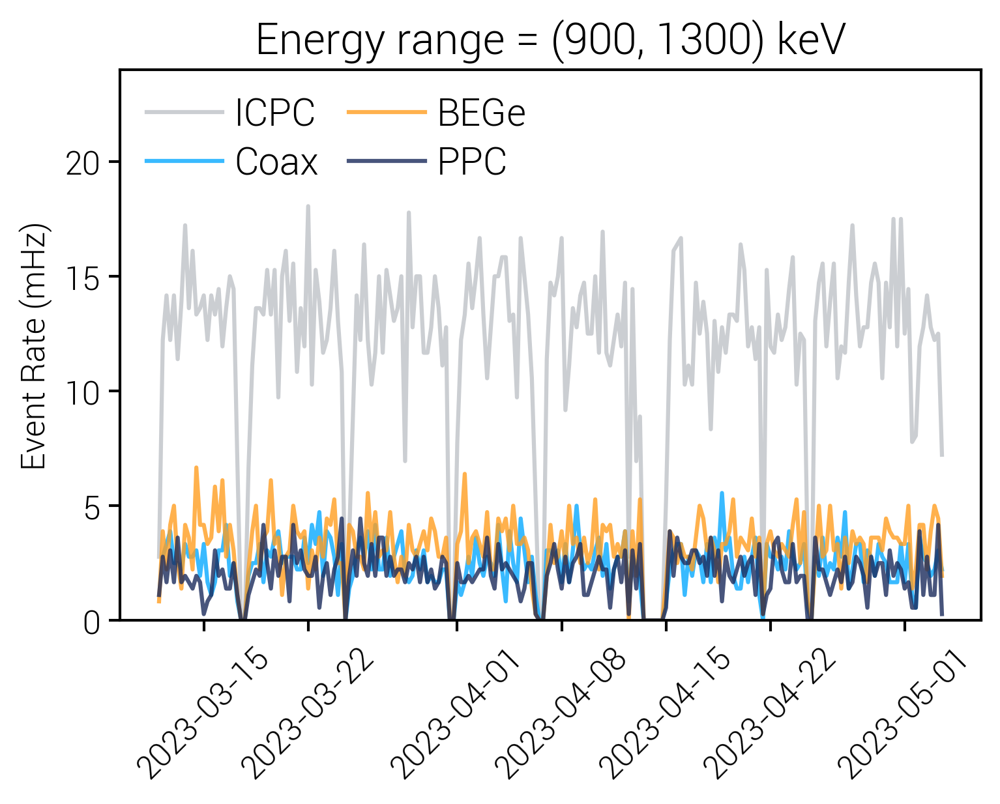

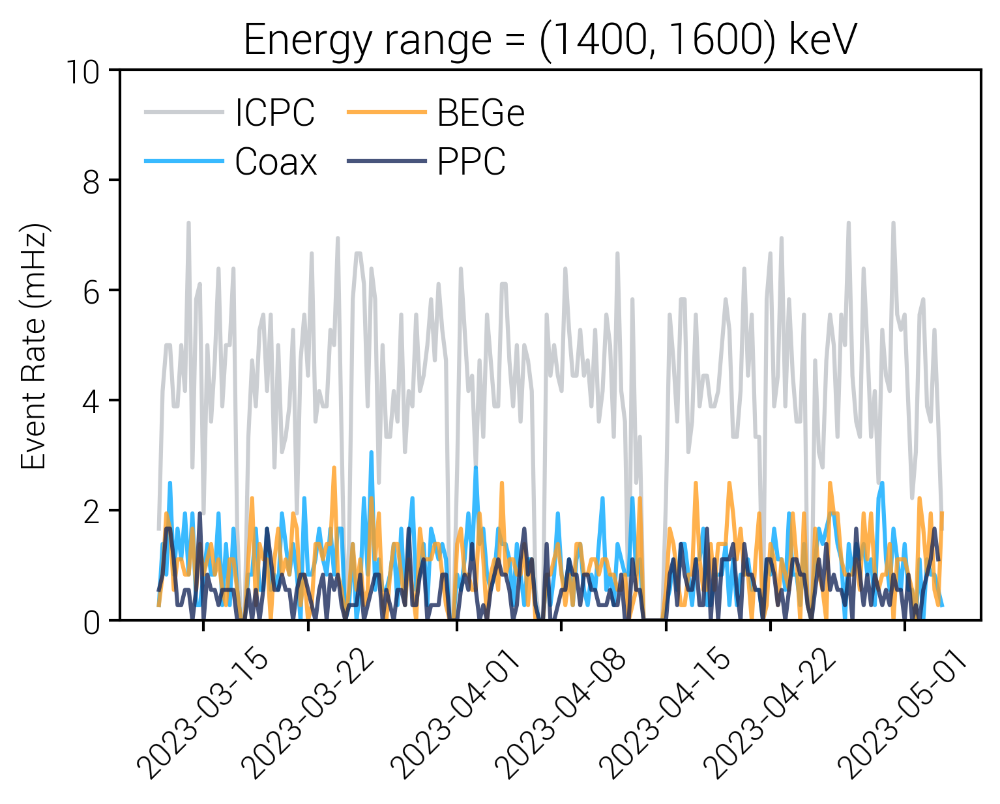

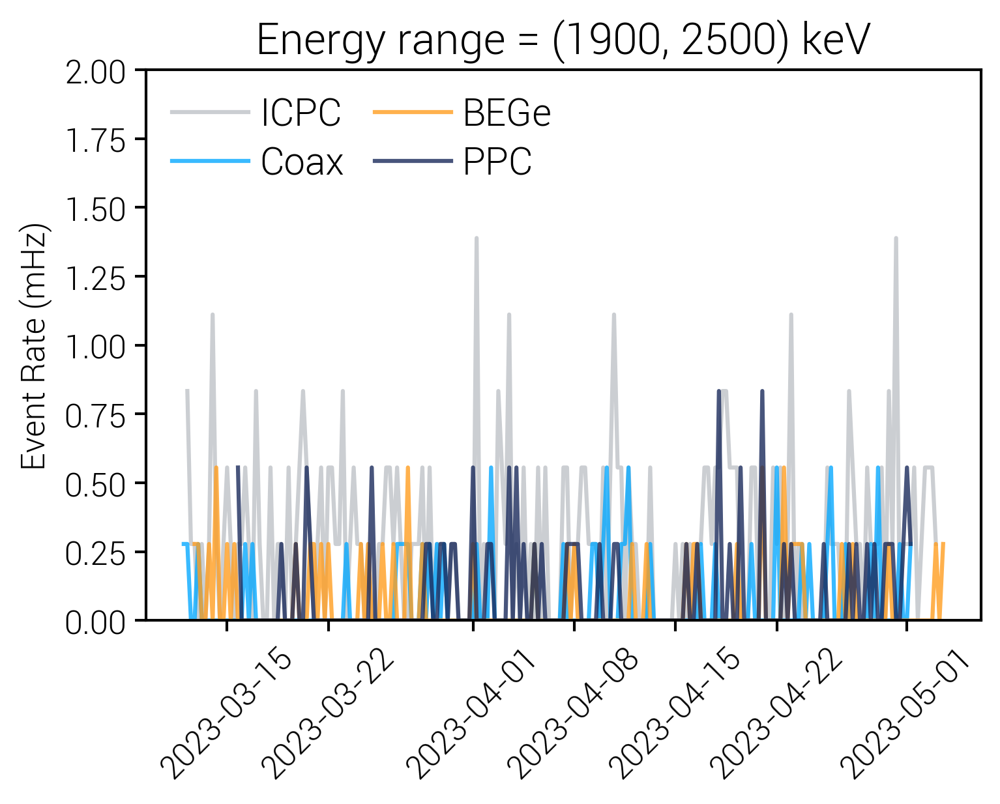

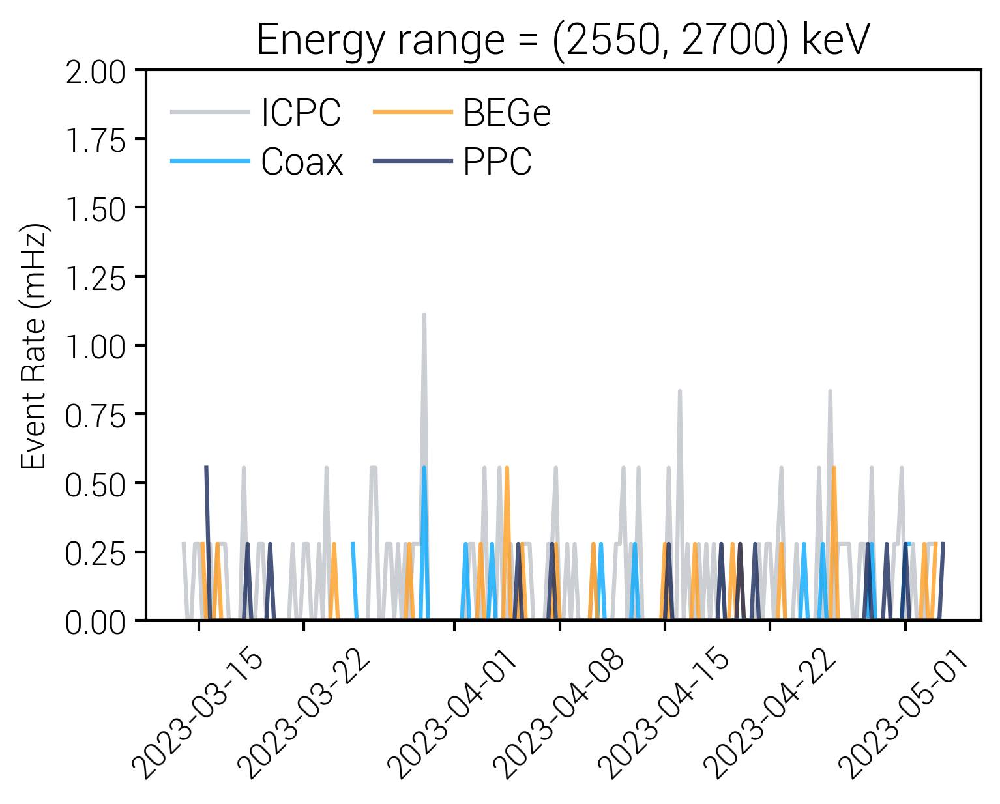

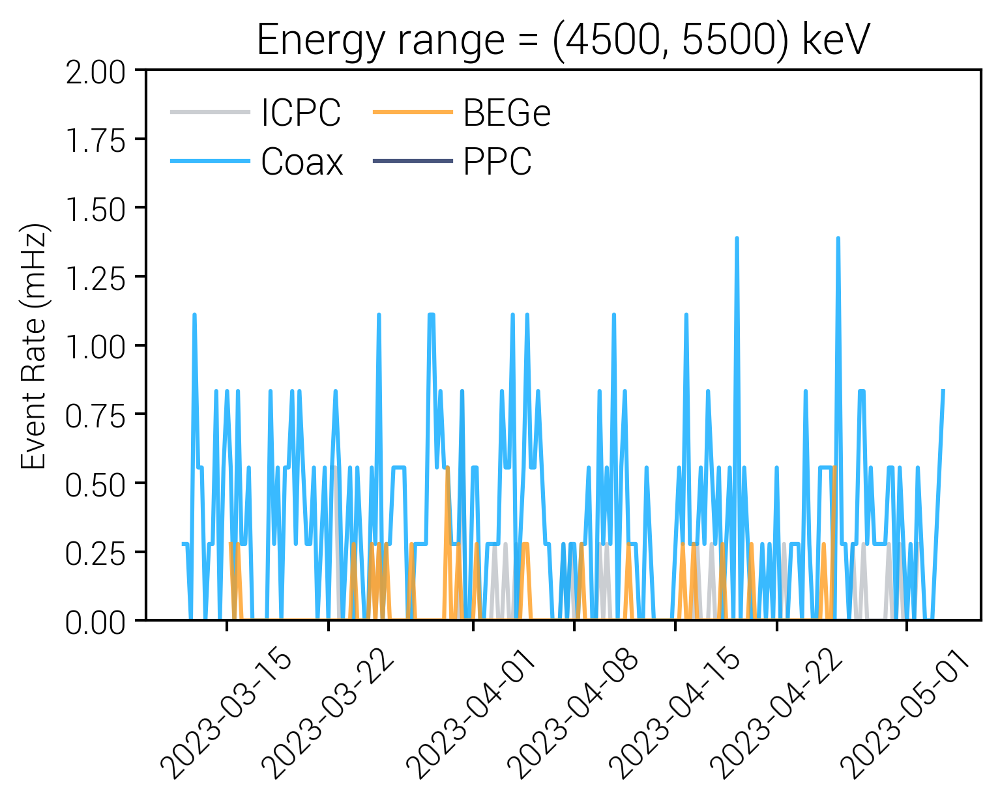

In [156]:
for (e1, e2), yl in zip(energy_ranges, [(0, 125), (0, 24), (0, 10), (0, 2), (0, 2), (0, 2)]):
    fig, ax = lps.subplots(figsize=(5, 4))
    for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
        det_lab         = nice_det_name_dict[d_type]
        data_filt_det_e = data_filt[(data_filt.det_type==d_type) & (data_filt.energy>e1) & (data_filt.energy<=e2)]
        data_filt_det_e_s = resample_df(data_filt_det_e, timestamp='6H')
        plt.plot(data_filt_det_e_s.index, data_filt_det_e_s, linewidth=1.5, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
        plt.title(f'Energy range = ({e1}, {e2}) keV', fontsize=16)
        plt.ylabel('Event Rate (mHz)')
        plt.legend(fontsize=14, loc='upper left', ncol=2)
        plt.xticks(rotation=45)# Rotate x-axis labels for better readability
        plt.ylim(yl)
        #plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
    plt.show()

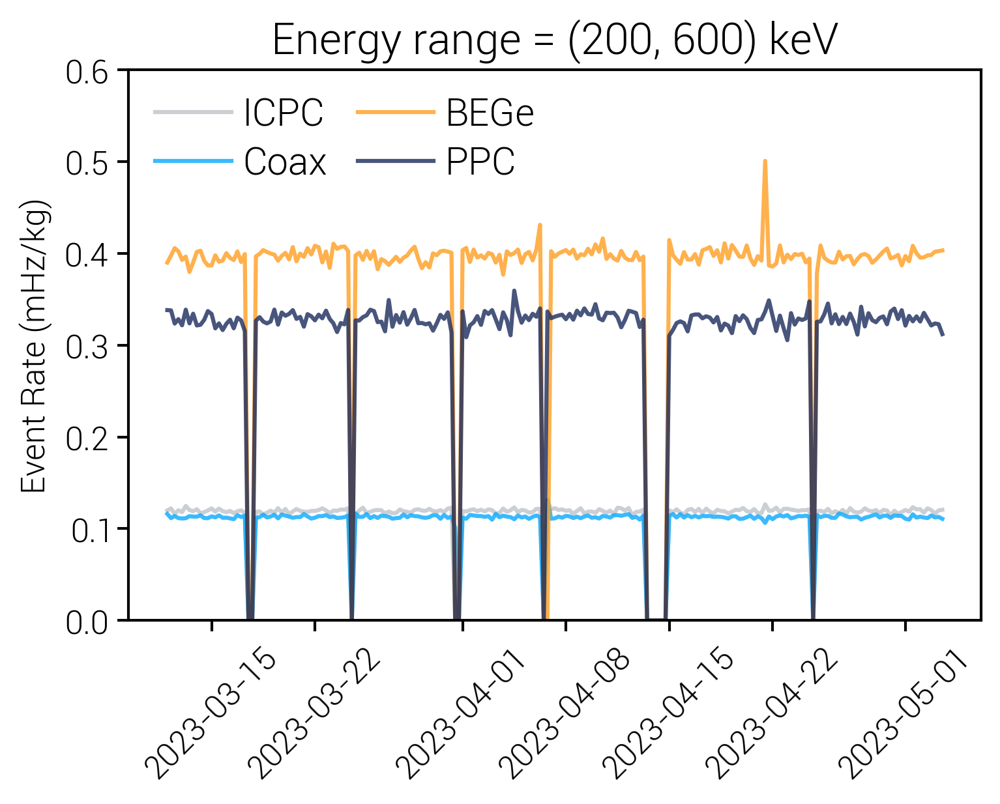

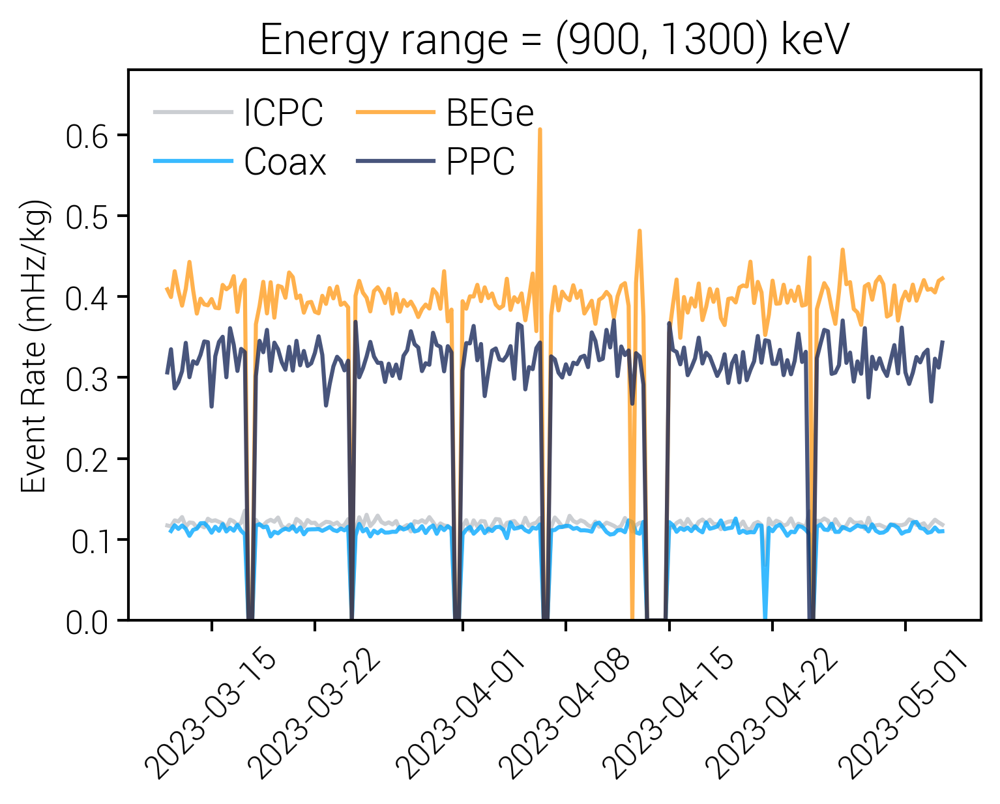

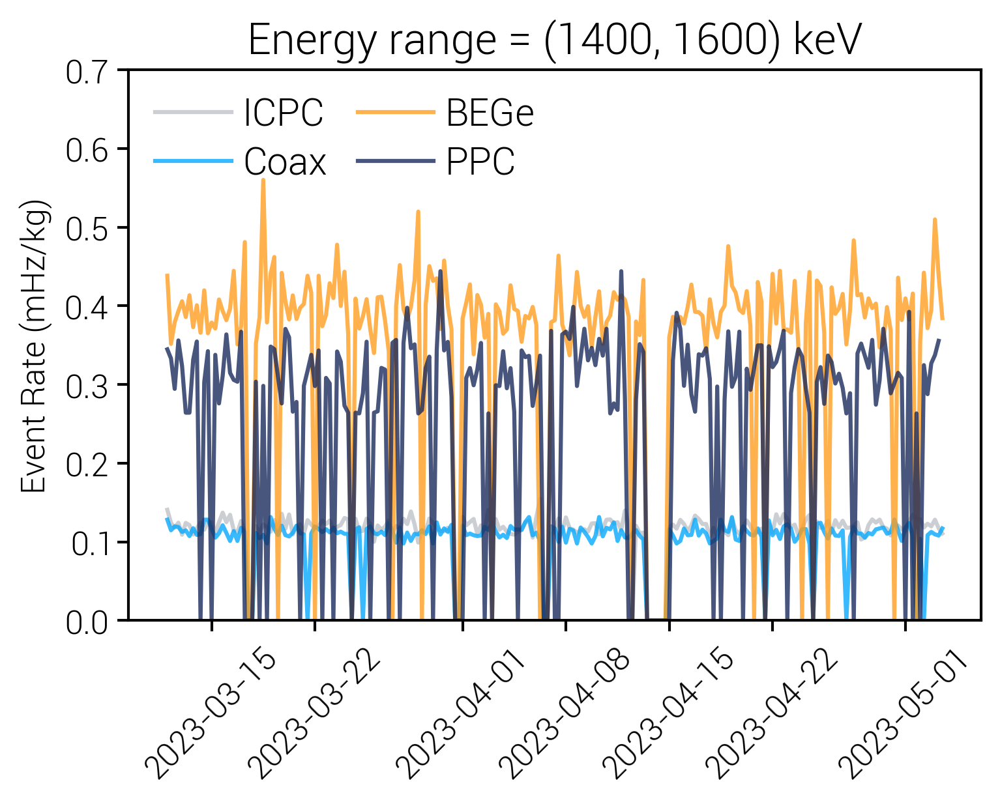

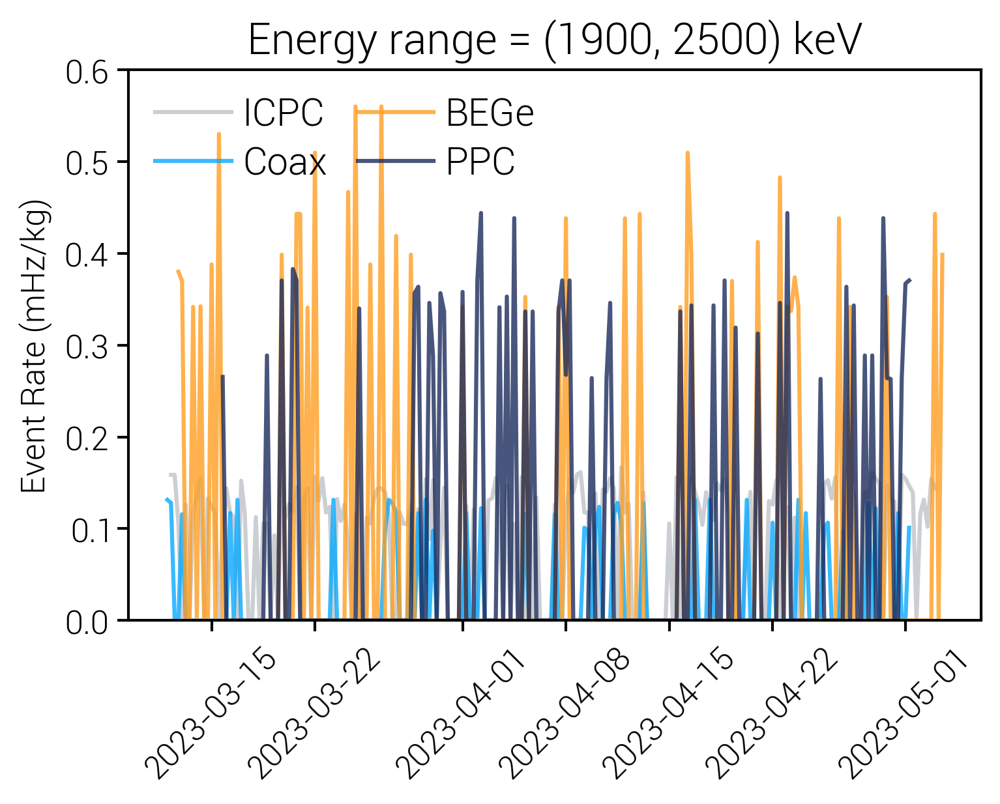

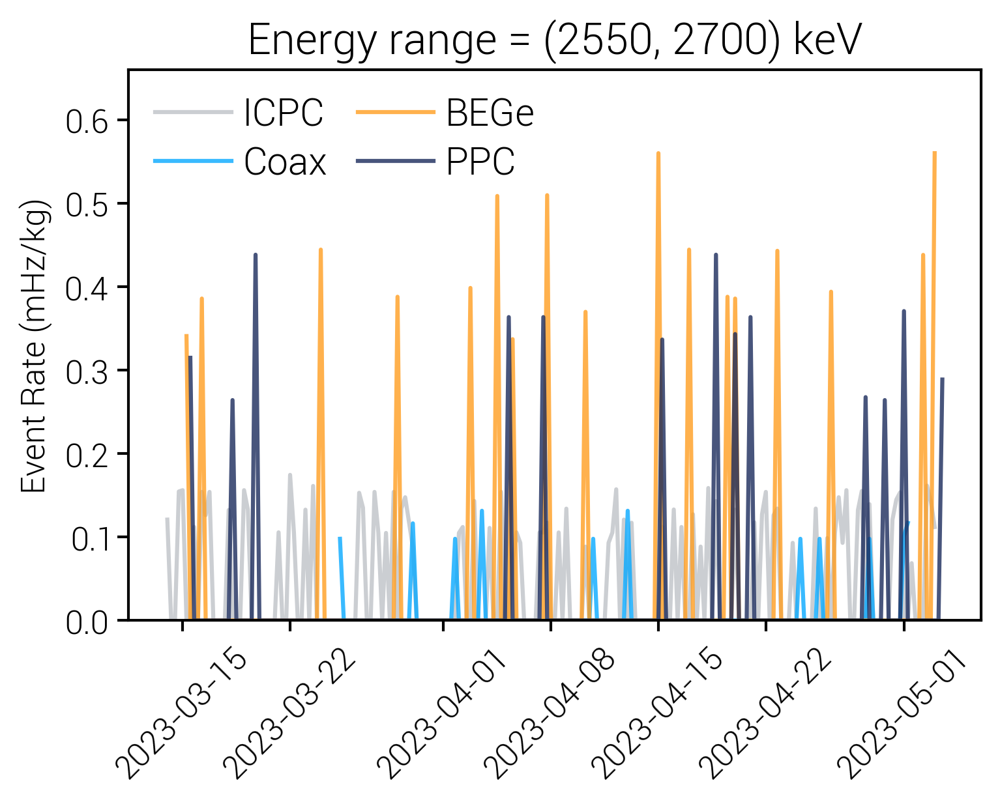

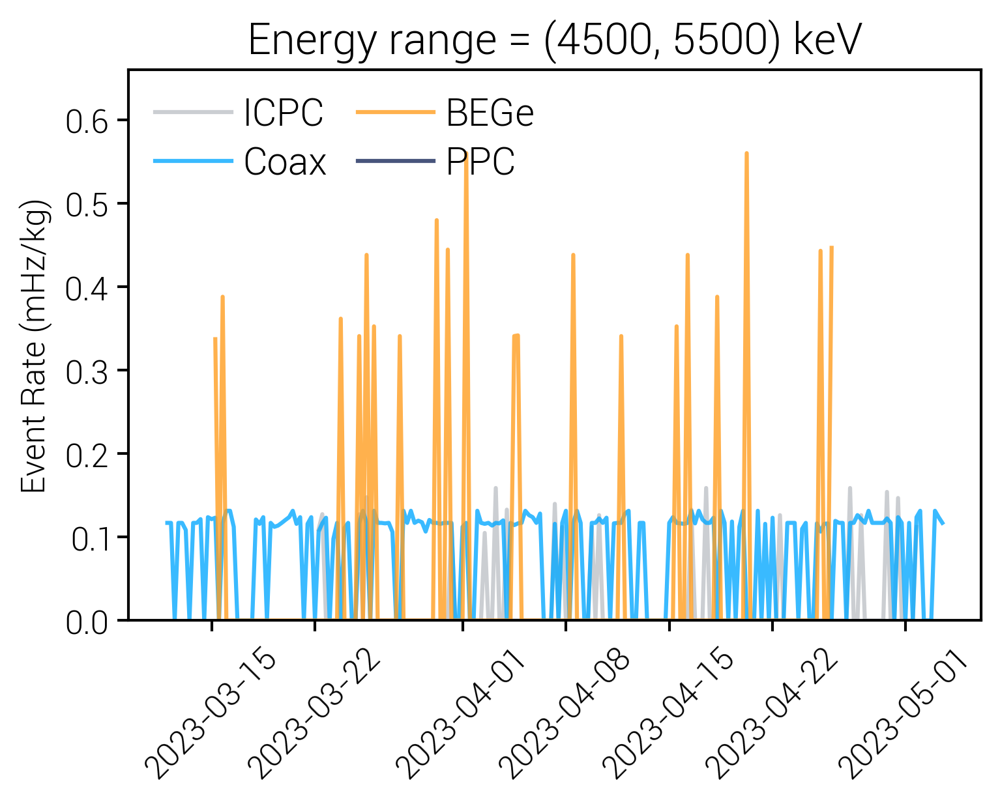

In [164]:
for (e1, e2), yl in zip(energy_ranges, [(0, 0.60), (0, 0.68), (0, 0.7), (0, 0.6), (0, 0.66), (0, 0.66)]):
    fig, ax = lps.subplots(figsize=(5, 4))
    for d_type, col in zip(nice_det_name_dict.keys(), det_colors_leg_style):
        det_lab         = nice_det_name_dict[d_type]
        data_filt_det_e = data_filt[(data_filt.det_type==d_type) & (data_filt.energy>e1) & (data_filt.energy<=e2)]
        data_filt_det_e_s = resample_df_norm_mass(data_filt_det_e, timestamp='6H')
        ax.plot(data_filt_det_e_s.index, data_filt_det_e_s, linewidth=1.5, color=lps.colors[col], alpha=0.8, label=f'{det_lab}')
        ax.set_title(f'Energy range = ({e1}, {e2}) keV', fontsize=16)
        ax.set_ylabel('Event Rate (mHz/kg)')
        plt.legend(fontsize=14, loc='upper left', ncol=2)
        plt.xticks(rotation=45)# Rotate x-axis labels for better readability
        plt.ylim(yl)
        #plt.xlim(pd.to_datetime('2023-03-10'), pd.to_datetime('2023-05-1'))
    plt.show()

### Silver and golden datasets:

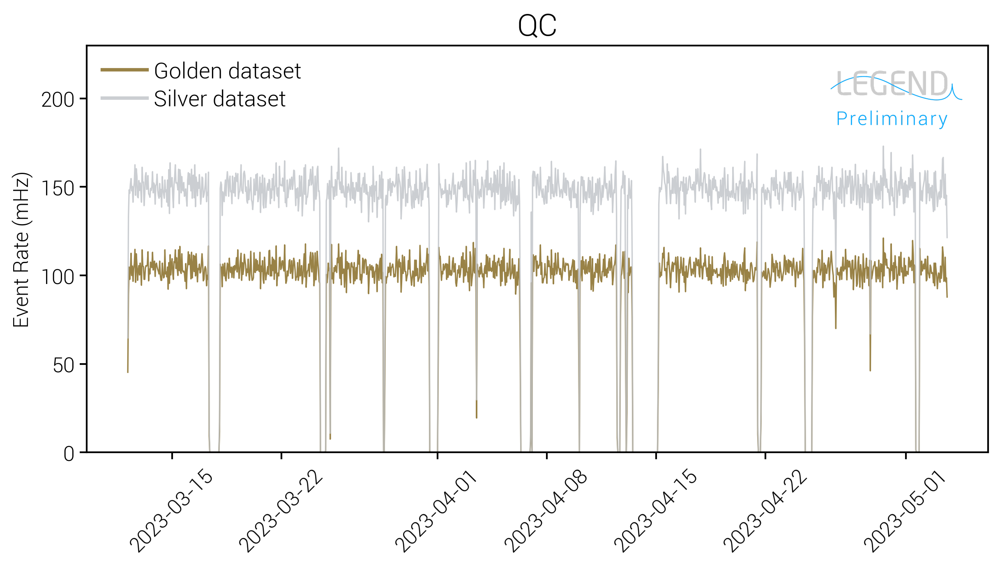

In [180]:
data_golden = data_filt[data_filt.is_usable_aoe == True]
data_silver = data_filt
data_golden_series = resample_df(data_golden)
data_silver_series = resample_df(data_silver)
fig, ax = lps.subplots()
#ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
ax.plot(data_golden_series.index, data_golden_series, linewidth=0.8, color=lps.colors['legend_gold'], alpha=0.8, label=f'Golden dataset')
ax.plot(data_silver_series.index, data_silver_series, linewidth=0.8, color=lps.colors['silver'],      alpha=0.8, label=f'Silver dataset')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title(f'{titl}', fontsize=18)
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=1, fontsize=13, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(0, 230)
plt.show()

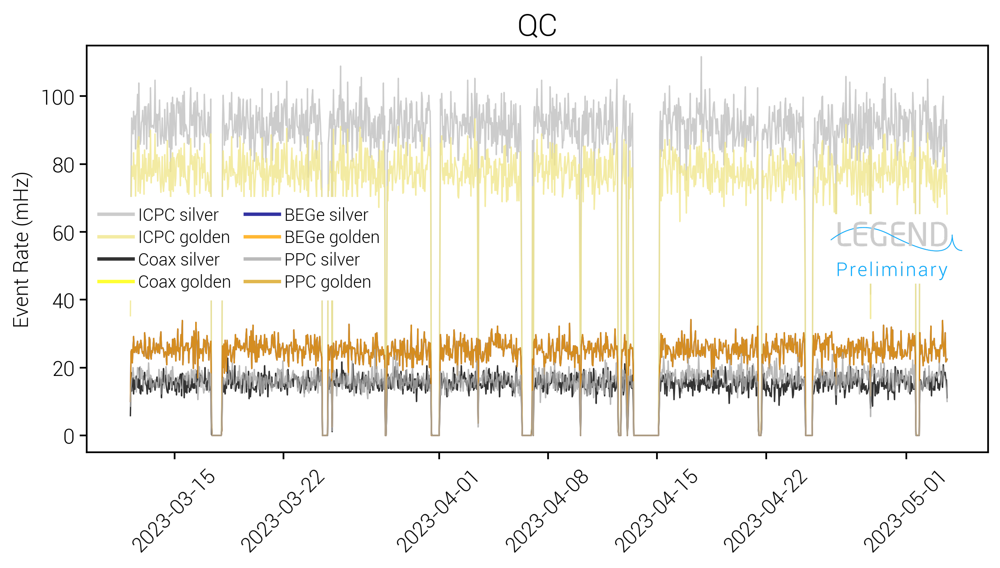

In [217]:
from matplotlib.patches import Rectangle

fig, ax = lps.subplots()
for d_type, col1, col2 in zip(nice_det_name_dict.keys(), ['khaki', 'yellow', 'orange', 'goldenrod'], ['silver', 'k', 'darkblue', 'darkgrey']):
    det_lab         = nice_det_name_dict[d_type]
    data_filt_det   = data_filt[data_filt.det_type==d_type]
    
    data_golden = data_filt_det[data_filt_det.is_usable_aoe == True]
    data_silver = data_filt_det
    data_golden_series = resample_df(data_golden, timestamp='1H')
    data_silver_series = resample_df(data_silver, timestamp='1H')
    #ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    ax.plot(data_silver_series.index, data_silver_series, linewidth=0.8, color=col2, alpha=0.8, label=f'{det_lab} silver', zorder=1)
    ax.plot(data_golden_series.index, data_golden_series, linewidth=0.8, color=col1, alpha=0.8, label=f'{det_lab} golden', zorder=1)
    ax.set_title(f'QC', fontsize=18)
    ax.set_ylabel('Event Rate (mHz)')

start_date  = pd.to_datetime('2023-04-26')
end_date    = pd.to_datetime('2023-05-03')
start_date2 = pd.to_datetime('2023-03-12')
end_date2   = pd.to_datetime('2023-03-28')
num_start  = mdates.date2num(start_date)
num_end    = mdates.date2num(end_date)
num_start2 = mdates.date2num(start_date2)
num_end2   = mdates.date2num(end_date2)
square1 = Rectangle((num_start, 45), num_end - num_start, 20, edgecolor='white', facecolor='white', zorder=2)
plt.gca().add_patch(square1)
square2 = Rectangle((num_start2, 40), num_end2 - num_start2, 30, edgecolor='white', facecolor='white', zorder=2)
plt.gca().add_patch(square2)
ax.set_legend_logo(position='center right', logo_type = 'preliminary')
leg = ax.legend(ncol=2, fontsize=10, loc='center left', shadow=False)
for line in leg.get_lines():
    line.set_linewidth(2)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(-5, 115)
plt.show()

### Separate data before and after veto cut

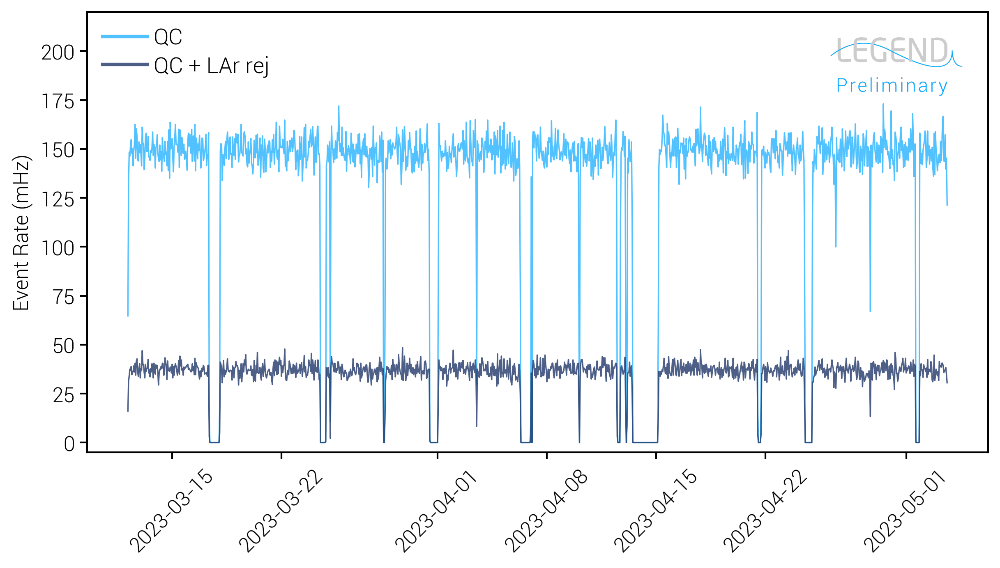

In [223]:
data_filt_lar_rej        = data_filt[data_filt.is_lar_rejected==False]
data_filt_lar_rej_series = resample_df(data_filt_lar_rej)

fig, ax = lps.subplots()
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.plot(data_filt_series        .index, data_filt_series        , linewidth=0.8, color=lps.colors['legend_blue'], alpha=0.7, label='QC')
ax.plot(data_filt_lar_rej_series.index, data_filt_lar_rej_series, linewidth=0.8, color=lps.colors['darkblue'], alpha=0.8, label='QC + LAr rej')
#plt.title('Time bin (1H)')
ax.set_ylabel('Event Rate (mHz)')
#plt.legend(fontsize=13, loc='upper left')
leg = ax.legend(ncol=1, fontsize=13, loc='upper left', shadow=False)
for line in leg.get_lines():
    line.set_linewidth(2)
plt.xticks(rotation=45)# Rotate x-axis labels for better readability
plt.ylim(-5, 220)
plt.show()

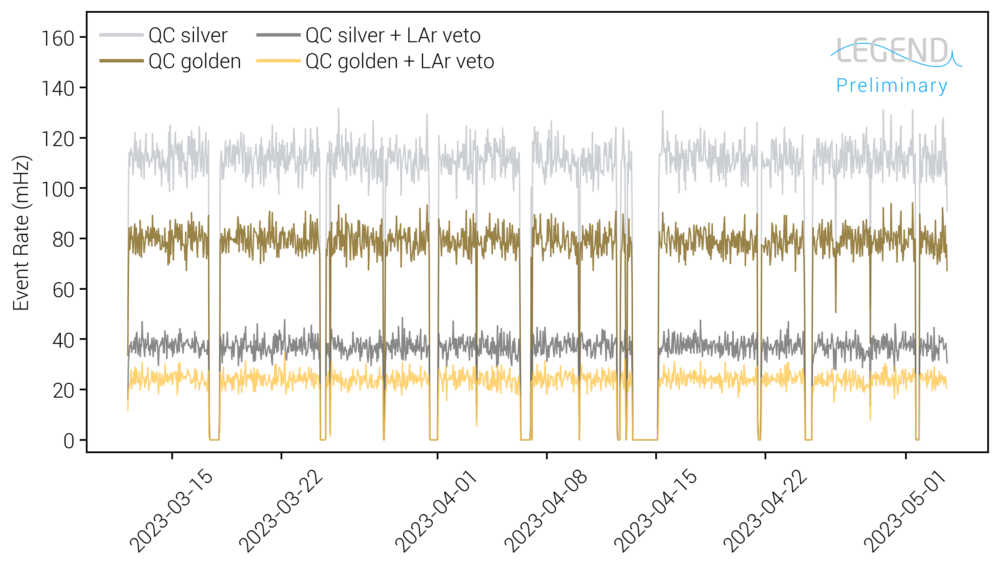

In [246]:
timestamp = '1H'
colors  = [(lps.colors['silver'], lps.colors['legend_gold']), ('dimgrey', lps.colors['yellow'])]
labs    = [('QC silver', 'QC golden'), ('QC silver + LAr veto', 'QC golden + LAr veto')]
vals    = [True, False]
fig, ax = lps.subplots()
for val, (col1, col2), (lab1, lab2) in zip(vals, colors, labs):
    data_cut_silver        = data_filt[data_filt.is_lar_rejected==val]
    data_cut_silver_series = resample_df(data_cut_silver, timestamp)
    data_cut_gold          = data_filt[(data_filt.is_usable_aoe==True)&(data_filt.is_lar_rejected==val)]
    data_cut_gold_series   = resample_df(data_cut_gold, timestamp)
    ax.plot(data_cut_silver_series.index, data_cut_silver_series, linewidth=0.8, color=col1, alpha=0.8, label=f'{lab1}')
    ax.plot(data_cut_gold_series.index, data_cut_gold_series, linewidth=0.8, color=col2, alpha=0.8, label=f'{lab2}')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=2, fontsize=12, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(-5, 170)
plt.show()

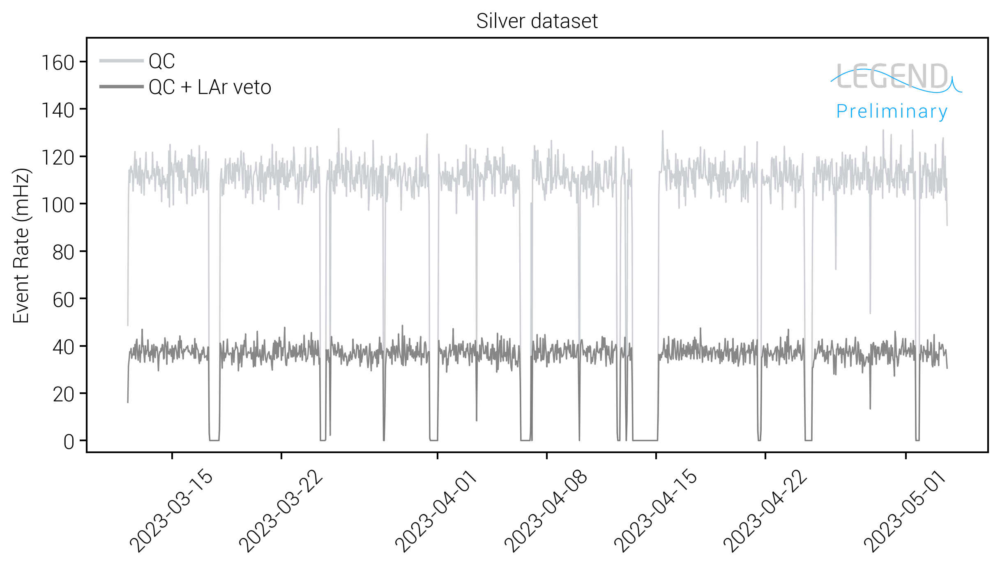

In [248]:
timestamp = '1H'
colors  = [lps.colors['silver'], 'dimgrey']
labs    = ['QC', 'QC + LAr veto']
vals    = [True, False]
fig, ax = lps.subplots()
for val, col, lab in zip(vals, colors, labs):
    data_cut_silver        = data_filt[data_filt.is_lar_rejected==val]
    data_cut_silver_series = resample_df(data_cut_silver, timestamp)
    ax.plot(data_cut_silver_series.index, data_cut_silver_series, linewidth=0.8, color=col, alpha=0.8, label=f'{lab}')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title('Silver dataset')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=1, fontsize=12, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(-5, 170)
plt.show()

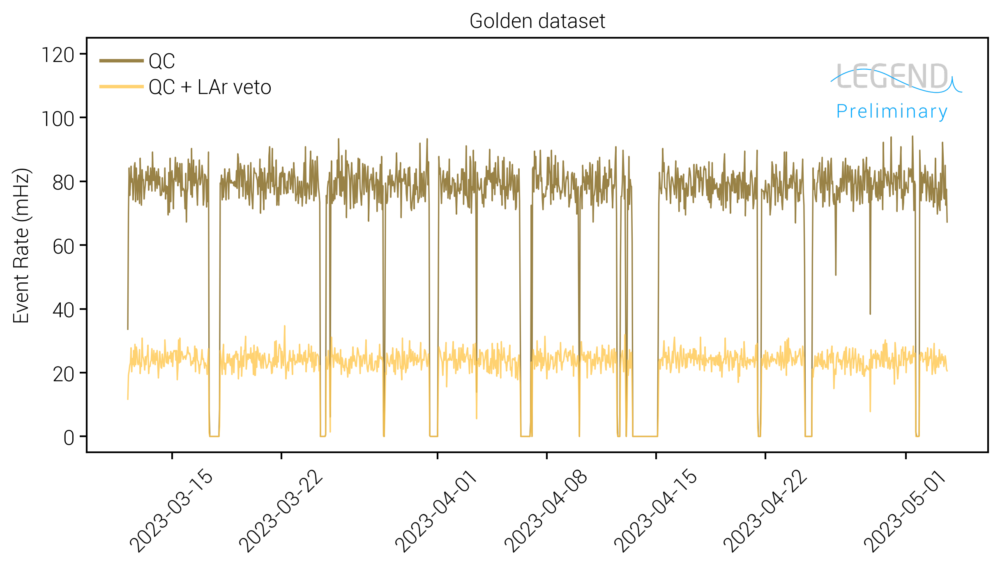

In [254]:
timestamp = '1H'
colors  = [lps.colors['legend_gold'], lps.colors['yellow']]
labs    = ['QC', 'QC + LAr veto']
vals    = [True, False]
fig, ax = lps.subplots()
for val, col, lab in zip(vals, colors, labs):
    data_cut_gold          = data_filt[(data_filt.is_usable_aoe==True)&(data_filt.is_lar_rejected==val)]
    data_cut_gold_series   = resample_df(data_cut_gold, timestamp)
    ax.plot(data_cut_gold_series.index, data_cut_gold_series, linewidth=0.8, color=col, alpha=0.8, label=f'{lab}')
ax.set_legend_logo(position='upper right', logo_type = 'preliminary')
ax.set_title('Golden dataset')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=1, fontsize=12, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(-5, 125)
plt.show()

### Different timestamps:

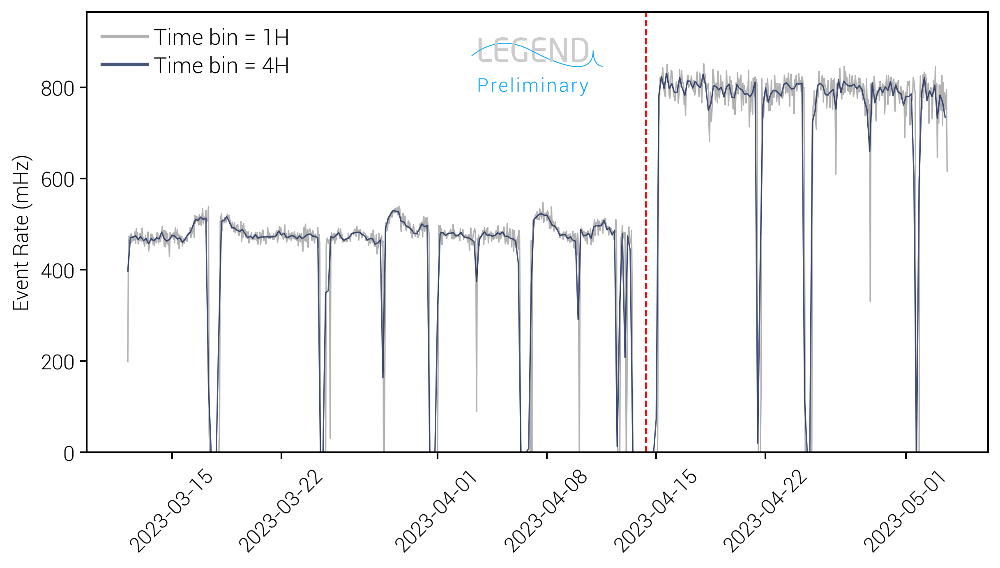

In [40]:
data_4h_sr = resample_df(data, timestamp='4H')

fig, ax = lps.subplots()
ax.plot(data_series.index, data_series,  linewidth=0.8, color='grey',                        alpha=0.6, label='Time bin = 1H')
ax.plot(data_4h_sr .index, data_4h_sr/4, linewidth=0.8, color=lps.colors['legend_darkblue'], alpha=0.8, label='Time bin = 4H')
ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
ax.set_legend_logo(position='upper center', logo_type = 'preliminary')
ax.set_ylabel('Event Rate (mHz)')
leg = ax.legend(ncol=1, fontsize=13, loc='upper left')
for line in leg.get_lines():
    line.set_linewidth(2)

ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
ax.set_ylim(0, 965)
plt.show()

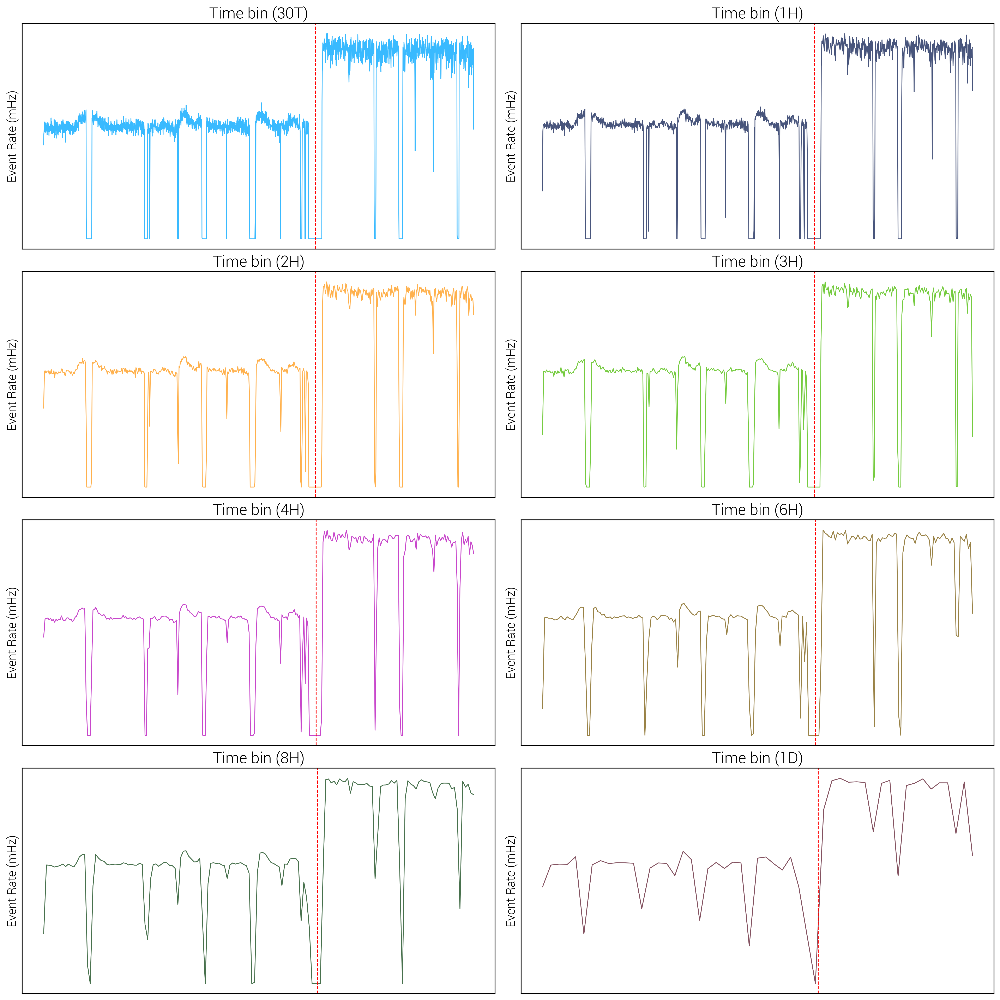

In [41]:
data_4h_sr = resample_df(data, timestamp='4H')

fig, axs = lps.subplots(4, 2, figsize=(16,16))
for ax, timest, col in zip(axs.flatten(), ['30T', '1H', '2H', '3H', '4H', '6H', '8H', '1D'], list(lps.colors.keys())[1:]):
    data_timest_sr = resample_df(data, timestamp=timest)
    ax.plot(data_timest_sr.index, data_timest_sr, linewidth=1, color=lps.colors[col], alpha=0.8)
    ax.axvline(x=vert_line_num, color='red', linestyle='--', label='')
    ax.set_title(f'Time bin ({timest})', fontsize=18)
    ax.set_ylabel('Event Rate (mHz)',    fontsize=14)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    ax.set_xticks([])
    ax.set_yticks([])
plt.show()

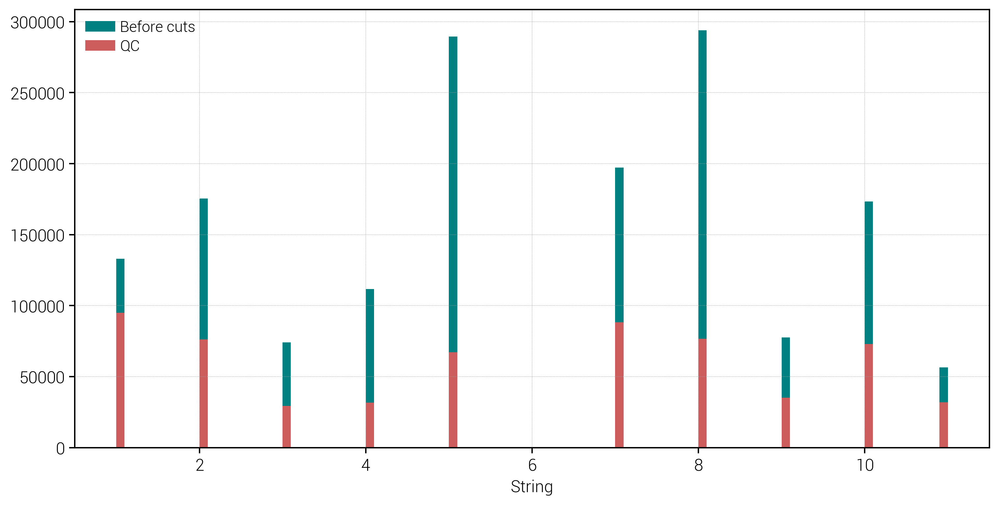

In [271]:
fig, ax = lps.subplots(figsize=(10,5))
data     .string.hist(bins=100, color='teal'     , label='Before cuts')
data_filt.string.hist(bins=100, color='indianred', label='QC')
plt.xlabel('String')
plt.legend();

### PLot the position of every detector

In [236]:
icpc_vals = [(v[3], v[4]) for k, v in channel_dict.items() if v[0] == 'icpc']
coax_vals = [(v[3], v[4]) for k, v in channel_dict.items() if v[0] == 'coax']
bege_vals = [(v[3], v[4]) for k, v in channel_dict.items() if v[0] == 'bege']
ppc_vals  = [(v[3], v[4]) for k, v in channel_dict.items() if v[0] == 'ppc']

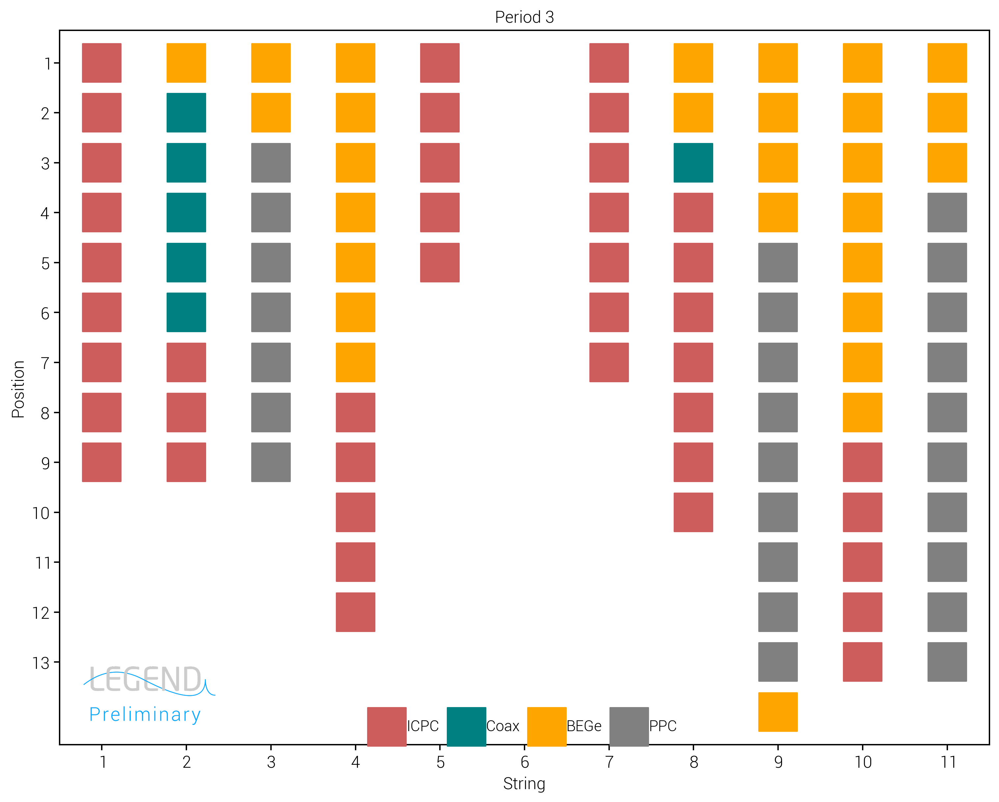

In [255]:
fig, ax = lps.subplots(figsize=(10, 8))
bin_width = 1
plt.scatter([icpc_val[0] for icpc_val in icpc_vals], [icpc_val[1] for icpc_val in icpc_vals], label='ICPC', marker='s', s=780, color='indianred')
plt.scatter([coax_val[0] for coax_val in coax_vals], [coax_val[1] for coax_val in coax_vals], label='Coax', marker='s', s=780, color='teal')
plt.scatter([bege_val[0] for bege_val in bege_vals], [bege_val[1] for bege_val in bege_vals], label='BEGe', marker='s', s=780, color='orange')
plt.scatter([ppc_val [0] for ppc_val  in ppc_vals ], [ppc_val [1] for ppc_val  in ppc_vals ], label='PPC',  marker='s', s=780, color='grey')
ax.set_legend_logo(position='lower left', logo_type = 'preliminary')
plt.xlabel('String')
plt.ylabel('Position')
plt.gca().invert_yaxis()
plt.title('Period 3')
plt.xticks(np.arange(min(data_p03_filt.string),   max(data_p03_filt.string)   + 1, bin_width))
plt.yticks(np.arange(min(data_p03_filt.position), max(data_p03_filt.position) + 1, bin_width))
plt.legend(loc='lower center', ncol=4)
plt.show()

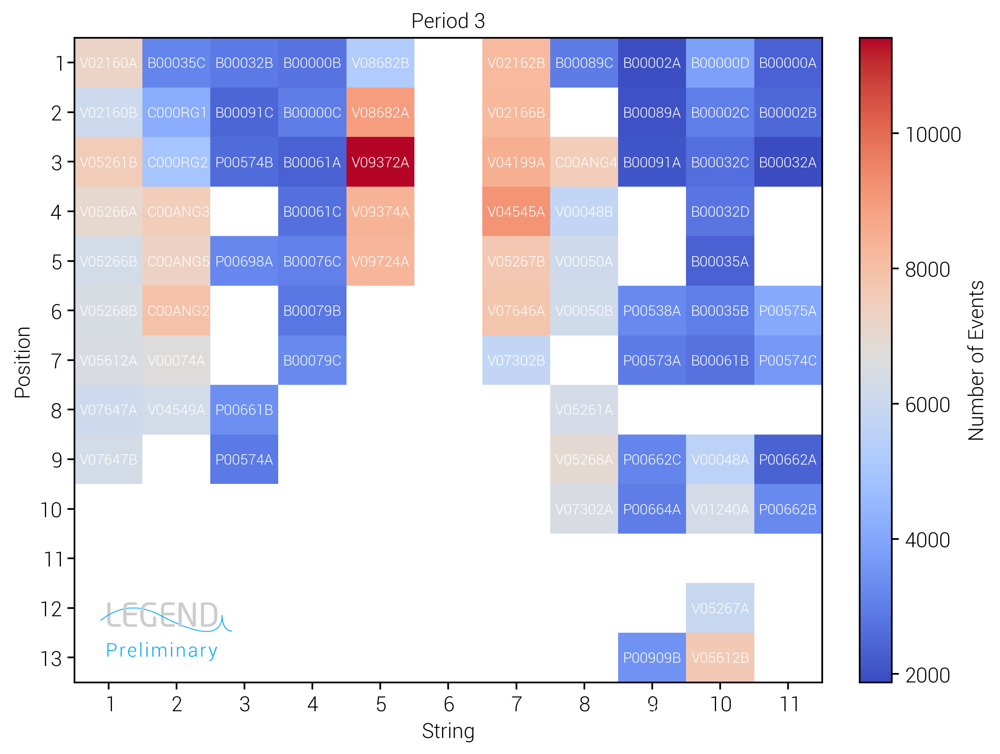

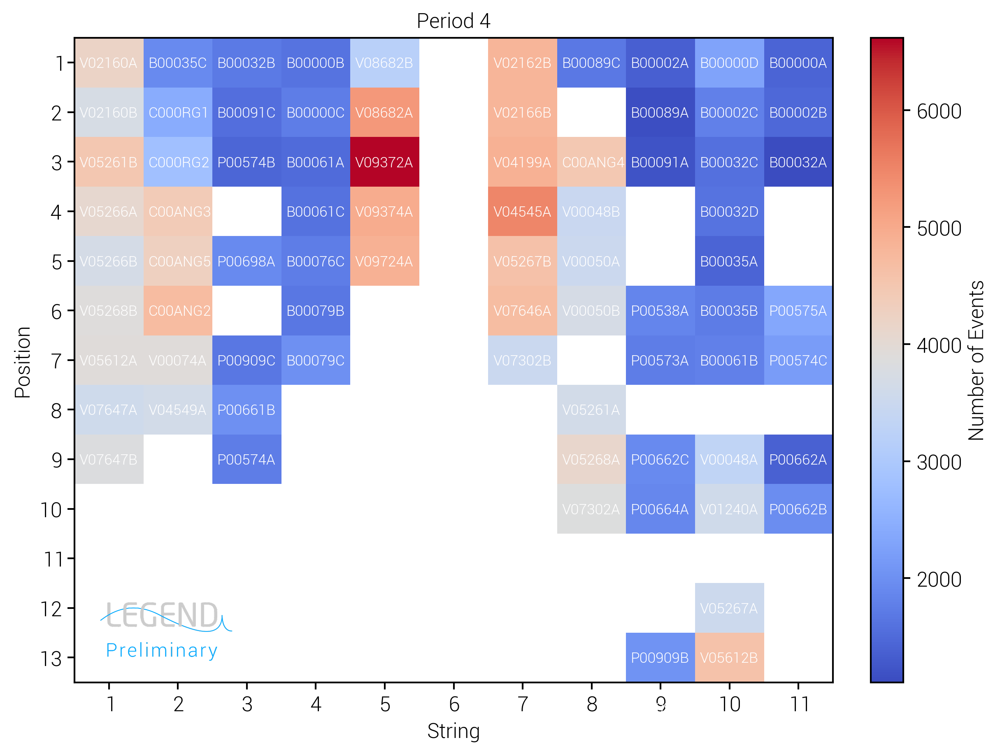

In [263]:
for data_sampl, title in zip([data_p03_filt, data_p04_filt], ['Period 3', 'Period 4']):
    fig, ax = lps.subplots(figsize=(8, 6))
    bin_width = 1
    x_bins = np.arange(min(data_sampl.string)   - bin_width / 2, max(data_sampl.string)   + bin_width / 2 + bin_width, bin_width)
    y_bins = np.arange(min(data_sampl.position) - bin_width / 2, max(data_sampl.position) + bin_width / 2 + bin_width, bin_width)
    for v in channel_dict.values():
        plt.text(v[3]-0.43, v[4]+0.1, v[1], color='white', fontsize=8.5, weight='bold')
    plt.hist2d(data_sampl.string, data_sampl.position, bins=[x_bins, y_bins], cmap='coolwarm', cmin=1)
    ax.set_legend_logo(position='lower left', logo_type = 'preliminary')
    plt.colorbar(label='Number of Events')
    plt.xlabel('String')
    plt.ylabel('Position')
    plt.gca().invert_yaxis()
    plt.title(title)
    plt.xticks(np.arange(min(data_sampl.string),   max(data_sampl.string)   + 1, bin_width))
    plt.yticks(np.arange(min(data_sampl.position), max(data_sampl.position) + 1, bin_width))
    plt.show()

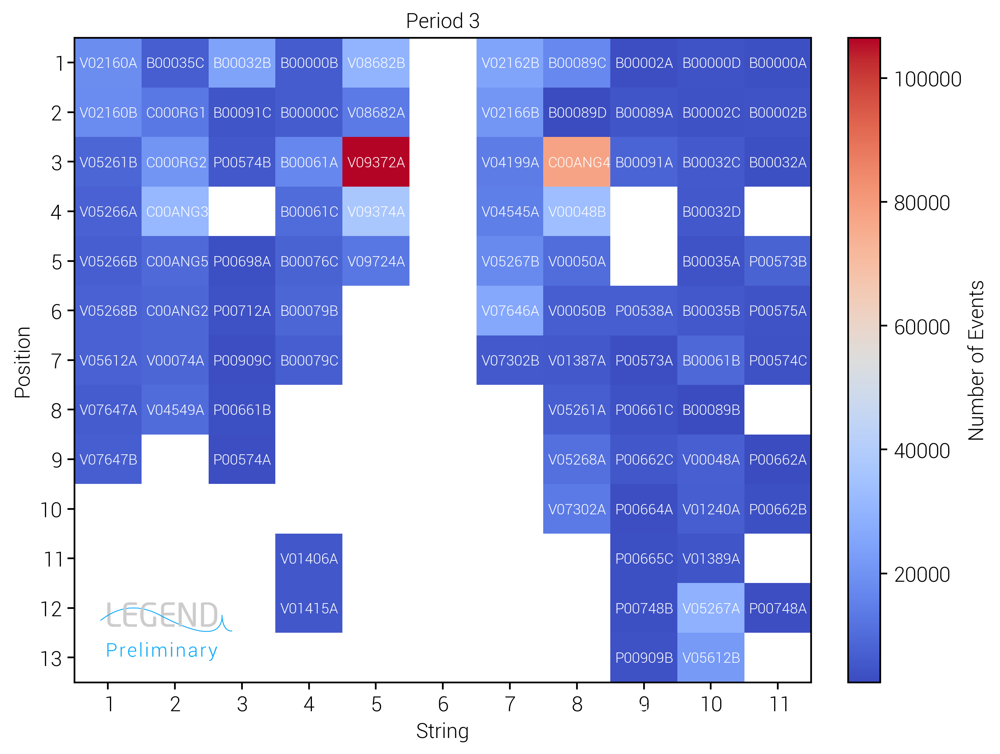

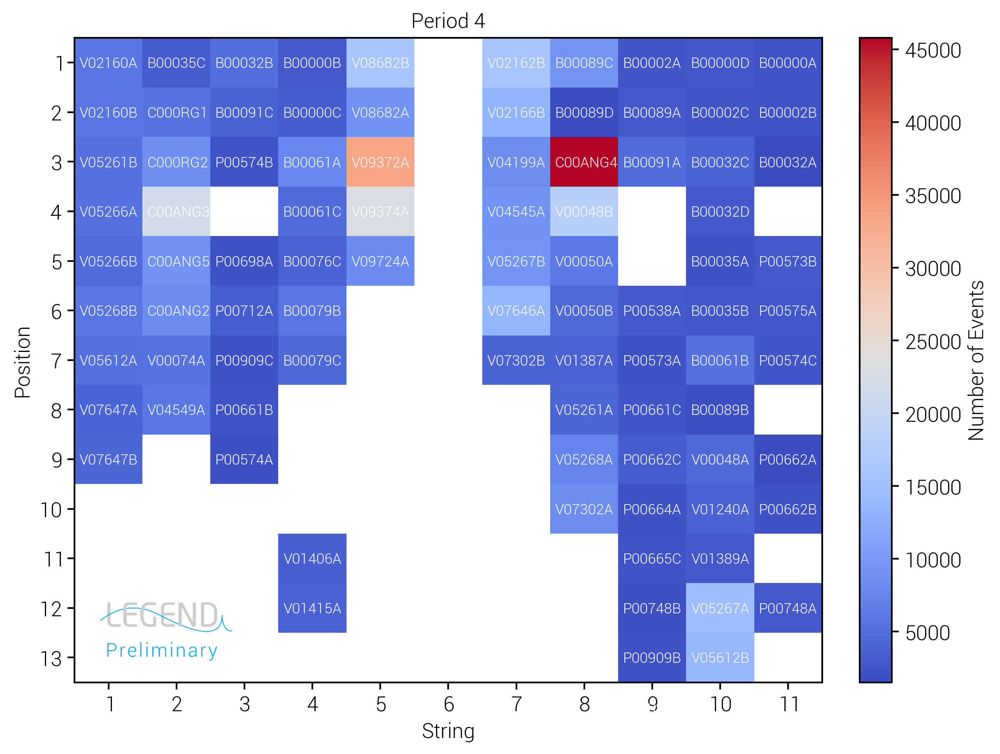

In [274]:
for data_sampl, title in zip([data_p03, data_p04], ['Period 3', 'Period 4']):
    data_sampl = data_sampl.fillna(0)
    sel = (data_sampl.string>0)&(data_sampl.position>0)
    fig, ax = lps.subplots(figsize=(8, 6))
    bin_width = 1
    x_bins = np.arange(min(data_sampl.string  [sel]) - bin_width / 2, max(data_sampl.string  [sel]) + bin_width / 2 + bin_width, bin_width)
    y_bins = np.arange(min(data_sampl.position[sel]) - bin_width / 2, max(data_sampl.position[sel]) + bin_width / 2 + bin_width, bin_width)
    for v in channel_dict.values():
        plt.text(v[3]-0.43, v[4]+0.1, v[1], color='white', fontsize=8.5, weight='bold')
    plt.hist2d(data_sampl.string[sel], data_sampl.position[sel], bins=[x_bins, y_bins], cmap='coolwarm', cmin=1)
    ax.set_legend_logo(position='lower left', logo_type = 'preliminary')
    plt.colorbar(label='Number of Events')
    plt.xlabel('String')
    plt.ylabel('Position')
    plt.gca().invert_yaxis()
    plt.title(title)
    plt.xticks(np.arange(min(data_sampl.string  [sel]), max(data_sampl.string  [sel])   + 1, bin_width))
    plt.yticks(np.arange(min(data_sampl.position[sel]), max(data_sampl.position[sel]) + 1, bin_width))
    plt.show()

ValueError: x and y must be the same size

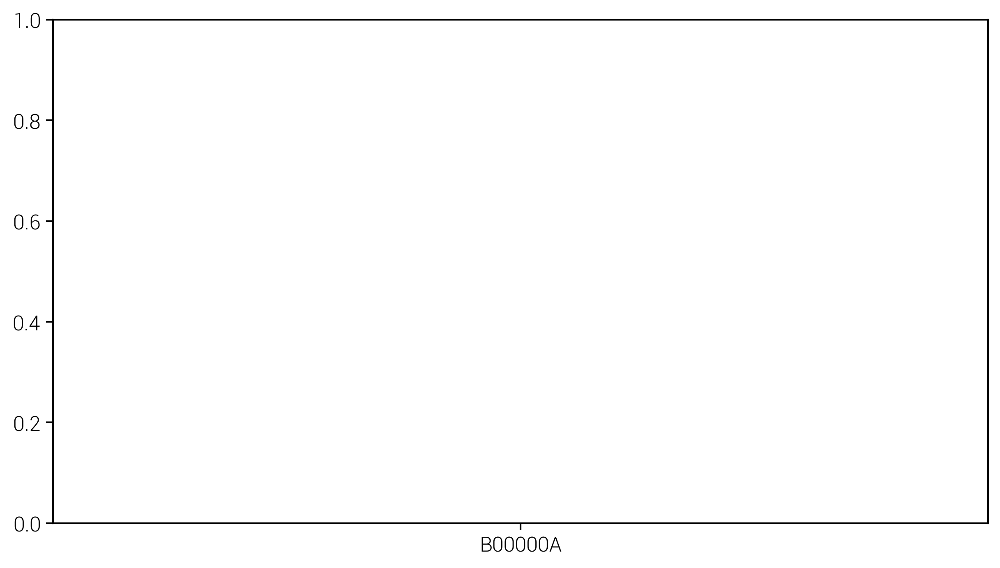

In [290]:
### channel_counts = data_p03_filt.channel_name.value_counts().sort_index()
### sorted_channels = channel_counts.index
### plt.scatter(sorted_channels, channel_counts)
### plt.xticks(rotation=90, fontsize=8)
### plt.xlabel('Channel Name')
### plt.ylabel('Frequency')
### plt.title('Period 3')
### plt.show()

#data_filt.channel_name.hist(bins=np.arange(data_filt.channel_name.nunique()))
#plt.xticks(rotation=90, fontsize=8);


channel_counts = data_filt['channel_name'].value_counts().sort_index()
sorted_channels = channel_counts.index
unique_det_types = data_p03_filt.det_type.unique()
for det_type in unique_det_types:
    subset_data = data_p03_filt[data_p03_filt.det_type == det_type]
    channel_counts = subset_data.channel_name.value_counts().sort_index()
    plt.scatter(sorted_channels, channel_counts, label=det_type)
plt.show()

In [288]:
data_p03_filt

,is_muon_tagged,is_baseline,is_pulser,multiplicity,on_multiplicity,energy,energy_aux,is_usable_aoe,is_usable_aoe_aux,aoe,...,lar_energy_dplms,lar_multiplicity_dplms,is_lar_rejected_dplms,lar_classifier,lar_time_shift,det_type,channel_name,mass,string,position
timestamp,,,,,,,,,,,,,,,,,,,,,
2023-03-12 04:34:08.543030016,False,False,False,1,1,768.904629,0.0,True,False,0.374784,...,0.000000,0,False,0.000000,NaN,icpc,V05268A,2298.0,8.0,9.0
2023-03-12 04:34:11.877814528,False,False,False,1,1,110.688307,0.0,True,False,-0.536870,...,17.239860,7,True,0.049540,47616.0,icpc,V04545A,3138.0,7.0,4.0
2023-03-12 04:34:12.890675200,False,False,False,1,1,240.441997,0.0,False,False,NaN,...,8.920335,3,True,0.104232,47872.0,ppc,P00662B,625.7,11.0,10.0
2023-03-12 04:34:14.249517568,False,False,False,1,1,52.407106,0.0,False,False,NaN,...,124.045487,18,True,0.469422,47168.0,coax,C00ANG3,2399.0,2.0,4.0
2023-03-12 04:34:21.265628160,False,False,False,1,1,81.479389,0.0,True,False,0.272457,...,28.032464,12,True,0.088491,47776.0,icpc,V05266A,2073.0,1.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-13 11:44:24.195259648,False,False,False,1,1,76.848578,0.0,False,False,NaN,...,1.910263,2,False,0.375185,47920.0,icpc,V05268B,1791.0,1.0,6.0
2023-04-13 11:44:27.840297472,False,False,False,1,1,146.299807,0.0,True,False,0.110298,...,0.000000,0,False,0.000000,NaN,icpc,V09372A,4046.0,5.0,3.0
2023-04-13 11:44:39.459742464,False,False,False,1,1,152.167161,0.0,True,False,0.388312,...,1.230378,1,False,1.000000,51408.0,icpc,V07647A,1893.0,1.0,8.0
